# Import packages and figure settings

In [1]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from skimage.measure import marching_cubes
import datetime
from pyproj import Transformer, Geod
import pandas as pd
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

from mpl_toolkits.basemap import Basemap
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from windrose import WindroseAxes
from scipy.integrate import cumulative_trapezoid
from skimage import measure
from scipy.interpolate import RegularGridInterpolator
from scipy import ndimage,interpolate
from scipy.signal import find_peaks
from matplotlib.ticker import FormatStrFormatter
from shapely import Point, unary_union
import matplotlib.gridspec as gridspec
import rasterio.features
from scipy.optimize import minimize
from scipy.signal import correlate
from scipy.interpolate import CubicSpline
from scipy.optimize import  NonlinearConstraint

plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['figure.dpi'] = 300
plt.rcParams['font.sans-serif'] = 'Arial' # Choose a nice font here
plt.rcParams['font.size'] = 12 # standard font size
plt.rcParams['mathtext.fontset'] ='dejavusans'
plt.rcParams['mathtext.rm'] = 'Arial'
plt.rcParams['mathtext.it'] = 'Arial'

# Parameters

In [2]:
kap  = 0.41 # von karman constant
rhos = 2380 # density gypsum
rhof = 1.225 # density air
grav = 9.81 # gravity
z00  = 1e-3 # roughness length from Gadal et al. 2020 (White Sands) and Ren et al. 2024 (Taklamakan)
d = 1e-4 # particle diameter - representive
nu = 1e-5 # viscocity - representive
phi = 0.62 # Pye and Tsoar 2009, the porosity of quartz dune sands is approximately 38%.

# Functions

In [3]:
# all functions in this block used to calculate wind velocity over terrain based on the stress perturbation theory
def get_ab(Rei,Re_di):
 
    ReiF   = True
    if not isinstance(Rei, np.ndarray):
        if type(Rei)==list:
            Rei    = np.array(Rei)
        else:
            Rei    = np.array([Rei])
            ReiF   = False            
    Re_diF = True
    if not isinstance(Re_di, np.ndarray):
        if type(Re_di)==list:
            Re_di  = np.array(Re_di)
        else:
            Re_di  = np.array([Re_di])
            Re_diF = False

    Re_d = np.logspace(-2,4, 60+1) # Re for saved solutions
    Re   = np.logspace(-2,8,100+1) # Re_d for saved solutions
    ab   = np.loadtxt('abcd.txt').reshape((4,len(Re),len(Re_d)))[:2] # saved solutions for A+iB

    # cubic interpolations for A and B based on saved solutions
    a_log10Re_log10Red = RegularGridInterpolator((np.log10(Re),np.log10(Re_d)),ab[0],method='cubic',bounds_error=False,fill_value=np.nan)
    b_log10Re_log10Red = RegularGridInterpolator((np.log10(Re),np.log10(Re_d)),ab[1],method='cubic',bounds_error=False,fill_value=np.nan)

    # grid of Re and Re_d to compute A and B on
    # A and B for Re when Re_d>1e+4 is equivalent to when Re_d=1e+4 but shifted 4 decades
    Reig   = np.where(Re_di[None,:]>Re_d[-1],10**(np.log10(Rei[:,None])+np.log10(Re_d[-1])-np.log10(Re_di[None,:])),Rei[:,None])
    # A and B for Re_d<1e-2 is equivalent to Re_d=1e-2
    Re_dig = np.clip(Re_di,Re_d[0],Re_d[-1])[None,:]

    abi   = np.stack((a_log10Re_log10Red((np.log10(Reig),np.log10(Re_dig))),
                      b_log10Re_log10Red((np.log10(Reig),np.log10(Re_dig)))))

    # for Re outside solved range, A and B are well approximated with extrapolation on powerlaw fit to edges of solved range
    if np.any(Reig<Re[0]):
        abiL = np.where(Reig<Re[0],10**np.stack((np.polyval(np.polyfit(np.log10(Re[:2]),
                   np.log10(a_log10Re_log10Red((np.log10(Re[:2])[:,None],np.log10(Re_dig)))),deg=1),
                   np.log10(Reig)),
                         np.polyval(np.polyfit(np.log10(Re[:2]),
                   np.log10(b_log10Re_log10Red((np.log10(Re[:2])[:,None],np.log10(Re_dig)))),deg=1),
                   np.log10(Reig)))),np.nan)
    else:
        abiL = abi*np.nan
    if np.any(Reig>Re[-1]):
        abiR = np.where(Reig>Re[-1],10**np.stack((np.polyval(np.polyfit(np.log10(Re[-2:]),
                   np.log10(a_log10Re_log10Red((np.log10(Re[-2:])[:,None],np.log10(Re_dig)))),deg=1),
                   np.log10(Reig)),
                         np.polyval(np.polyfit(np.log10(Re[-2:]),
                   np.log10(b_log10Re_log10Red((np.log10(Re[-2:])[:,None],np.log10(Re_dig)))),deg=1),
                   np.log10(Reig)))),np.nan)
    else:
        abiR = abi*np.nan
    
    abi = np.nansum(np.stack((abiL,abi,abiR)),0)
    
    if ReiF:
        if Re_diF:
            return abi
        else:
            return abi[:,:,0]
    else:
        if Re_diF:
            return abi[:,0,:]
        else:
            return abi[:,0,0]

def get_taupx_x(x,z,d,us,nu):
    
    import numpy as np
    from scipy.fft import ifft,fft,fftfreq
    
    # calculate terrain height FFT
    kz = fft(z-np.mean(z))

    # modify kx calculation
    kx = 2*np.pi*fftfreq(len(x),d=x[1]-x[0])
    kx[kx==0] = 1e-10 
    
    A,B = get_ab(us/nu/np.abs(kx),d*us/nu)

    taupx = ifft((A*np.abs(kx)+1j*B*kx)*kz).real
    
    return taupx

def get_taupx_xy(x,y,z,d,us,nu):
    
    import numpy as np
    from scipy.fft import ifft2,fft2,fftfreq
    
    # calculate terrain height FFT
    kz = fft2(z-np.mean(z))

    # modify kx calculation
    kx = 2*np.pi*fftfreq(len(x),d=x[1]-x[0])[:,None]
    ky = 2*np.pi*fftfreq(len(y),d=y[1]-y[0])[None,:]
    kx[kx==0] = 1e-10 
    ky[ky==0] = 1e-10 
    k = (kx**2+ky**2)**0.5
    
    A,B = get_ab(us/nu/np.abs(kx),d*us/nu)

    taupx = ifft2(kx/k*(A*kx+1j*B*np.abs(kx))*kz).real
    
    return taupx

def get_taupxy_xy(x,y,z,d,us,nu):
    
    import numpy as np
    from scipy.fft import ifft2,fft2,fftfreq
    
    # calculate terrain height FFT
    kz = fft2(z-np.mean(z))

    # modify kx calculation
    kx = 2*np.pi*fftfreq(len(x),d=x[1]-x[0])[:,None]
    ky = 2*np.pi*fftfreq(len(y),d=y[1]-y[0])[None,:]
    kx[kx==0] = 1e-10 
    ky[ky==0] = 1e-10 
    k = (kx**2+ky**2)**0.5
    
    Ax,Bx = get_ab(us/nu/np.abs(kx),d*us/nu)
    Ay,By = get_ab(us/nu/np.abs(ky),d*us/nu)/2
    
    taupx = ifft2(kx/k*(Ax*kx+1j*Bx*np.abs(kx))*kz).real
    taupy = ifft2(kx/k*(Ay*ky+1j*By*np.abs(ky))*kz).real

    return taupx+1j*taupy

def get_usxy_xy(taupxy,us):
    
    tauxy = taupxy+1
    return us*np.abs(tauxy)**0.5*np.exp(1j*np.angle(tauxy))

In [4]:
# function used to make recirculation bubbles in the dune leeside
def make_bubble(dt,varin,varout,recth,recsl,nroll=2,rbfmode='multiquadric',bzepsilon=1e-8,iterate=True):
    dx = np.diff(dt.x.data).mean()
    dy = np.diff(dt.y.data).mean()
    if (dt[varin].differentiate('x')<recth).any():
        temp0 = dt[varin].stack(p=('x','y'))
        temp1 = dt[varin].where(~((dt[varin]-dt.x*recsl)<(dt[varin].where(dt[varin].differentiate('x')<recth)-dt.x*recsl).cumulative('x').max())).to_dataset(name=varin)
        temp2 = ndimage.label(temp1[varin].isnull())
        temp5 = []
        for j in np.arange(temp2[1])+1:
            temp3 = temp2[0]==j
            temp4 = (~temp3)&ndimage.binary_dilation(temp3,iterations=nroll)
            temp3,temp4 = temp0.isel(p=np.where(temp3.flatten())[0]).to_dataset(),temp0.isel(p=np.where(temp4.flatten())[0]).to_dataset()
            rbffull = interpolate.RBFInterpolator(np.stack((temp4.x.data,temp4.y.data)).T,temp4[varin].data,kernel=rbfmode,epsilon=np.min([dx,dy]))
            temp3[varout] = (('p'),rbffull(np.stack((temp3.x.data,temp3.y.data)).T))
            if iterate:
                while (temp3[varout]<temp3[varin]).any():
                    temp4 = xr.concat((temp4,(temp3[varin].where(temp3[varout]<temp3[varin],drop=True)+bzepsilon).to_dataset()),'p')
                    rbffull = interpolate.RBFInterpolator(np.stack((temp4.x.data,temp4.y.data)).T,temp4[varin].data,kernel=rbfmode,epsilon=np.min([dx,dy]))
                    temp3[varout] = (('p'),rbffull(np.stack((temp3.x.data,temp3.y.data)).T))
            temp5.append(temp3[varout])
        return xr.merge((dt,xr.concat(temp5,'p').unstack()))
    else:
        dt[varout] = (('x','y'),np.zeros(dt[varin].shape)*np.nan)
        return dt

# extending domain to make the boundaries periodic
def make_pad(dt,varin,varout,padsl,nroll=2,rbfmode='multiquadric',bzepsilon=1e-8,iterate=True):
    z0 = dt[varin].min().data
    dx = dt.x.isel(x=slice(None,2)).diff('x').data[0]
    dy = dt.y.isel(y=slice(None,2)).diff('y').data[0]
    tempxyz = np.hstack((np.stack((dt.isel(x=0).x.data*np.ones(len(dt.isel(x=0).y)),dt.isel(x=0).y.data,dt.isel(x=0)[varin].data)),
                         np.stack((dt.isel(x=-1).x.data*np.ones(len(dt.isel(x=-1).y)),dt.isel(x=-1).y.data,dt.isel(x=-1)[varin].data)),
                         np.stack((dt.isel(y=0).x.data,dt.isel(y=0).y.data*np.ones(len(dt.isel(y=0).x)),dt.isel(y=0)[varin].data)),
                         np.stack((dt.isel(y=-1).x.data,dt.isel(y=-1).y.data*np.ones(len(dt.isel(y=-1).x)),dt.isel(y=-1)[varin].data)))).T
    padxy = -np.max(tempxyz[:,2])/padsl
    if ~((padxy<dx)&(padxy<dy)):
        padxy = np.ceil(padxy)
        temp = unary_union([Point(val[0],val[1]).buffer(-(val[2]-z0)/padsl) for val in tempxyz])
        dp = xr.Dataset(coords=dict(x=(['x'],np.arange(dt.x.min()-padxy-nroll*dx,dt.x.max()+padxy+nroll*dx+dx,dx)),
                                    y=(['y'],np.arange(dt.y.min()-padxy-nroll*dy,dt.y.max()+padxy+nroll*dy+dy,dy))))
        dp['bm'] = (('x','y'),rasterio.features.rasterize([temp],out_shape=[len(dp.y),len(dp.x)],
                                               transform=(dx,0,dp.x.isel(x=0).data,0,dy,dp.y.isel(y=0).data,0,0,1),
                                               all_touched=False).T)
        dp[varin] = dt[varin]
        dp['bm'] = (dp[varin].isnull()&(dp.bm==1))
        temp0 = dp[varin].fillna(z0).stack(p=('x','y'))
        temp2 = ndimage.label(dp.bm)
        temp5 = []
        for j in np.arange(temp2[1])+1:
            temp3 = temp2[0]==j
            temp4 = (~temp3)&ndimage.binary_dilation(temp3,iterations=nroll)
            temp3,temp4 = temp0.isel(p=np.where(temp3.flatten())[0]).to_dataset(),temp0.isel(p=np.where(temp4.flatten())[0]).to_dataset()
            rbffull = interpolate.RBFInterpolator(np.stack((temp4.x.data,temp4.y.data)).T,temp4[varin].data,kernel=rbfmode,epsilon=np.min([dx,dy]))
            temp3[varout] = (('p'),rbffull(np.stack((temp3.x.data,temp3.y.data)).T))
            if iterate:
                while (temp3[varout]<temp3[varin]).any():
                    temp4 = xr.concat((temp4,(temp3.z.where(temp3[varout]<temp3[varin],drop=True)+bzepsilon).to_dataset()),'p')
                    rbffull = interpolate.RBFInterpolator(np.stack((temp4.x.data,temp4.y.data)).T,temp4[varin].data,kernel=rbfmode,epsilon=np.min([dx,dy]))
                    temp3[varout] = (('p'),rbffull(np.stack((temp3.x.data,temp3.y.data)).T))
            temp5.append(temp3[varout])
        dp = xr.merge((dp,xr.concat(temp5,'p').unstack()))
        dp[varout] = xr.where(dp.z.isnull(),xr.where((~dp.bm)&(dp[varin].isnull()),z0,dp[varout]),dp.z)
        return dp
    else:
        dt[varout] = (('x','y'),dt[varin].data)
        dt['bm'] = (('x','y'),np.full(dt[varin].shape,False))
        return dt

In [5]:
# this function returns sand flux from the wind speed U at zU
def flux(U,zU,z0,constant=6.1,uscr=0.3):
    usabs = U*kap/np.log(zU/z0) # neutral law of the wall
    usabs[usabs<uscr] = uscr # get rid of negative unreal data
    return constant*rhof/rhos/grav*uscr*usabs**2*(1-(uscr/usabs)**2) 

# this function returns directions of wind vectors af, as +-180 from af0
def bearing_2_pm180_af0(ai,af0):
    # ai is the bearing of the wind
    # af0 is the direction of the wind vector you wish to set as the origin
    af = np.copy(ai)
    af = -af - af0 - 90
    af[af<-180] = af[af<-180] + 360
    return af

# Figure 1

In [7]:
fig, ax = plt.subplots(figsize=(8,6))
lw=1
fs=8
transformer = Transformer.from_crs("EPSG:26913", "EPSG:4326", always_xy=True)
lon, lat = transformer.transform(375954, 3630182)

xmin1,xmax1 = -106.35,-106.2
ymin1,ymax1 = 32.77,32.87
bmap = Basemap(epsg=4326,
               llcrnrlon=xmin1, llcrnrlat=ymin1,
               urcrnrlon=xmax1, urcrnrlat=ymax1)
bmap.arcgisimage(xpixels=1000,verbose=True)
bmap.drawmeridians(np.arange(xmin1,xmax1+0.05,0.05),linewidth=lw,color='k',labels=[True,False,False,True],fontsize=2*fs)
bmap.drawparallels(np.arange(ymin1,ymax1+0.05,0.05),linewidth=lw,color='k',labels=[True,False,False,True],fontsize=2*fs)

geod = Geod(ellps="WGS84")

# rotate
rect = np.array([[3000, 0], [8000, 0], [8000, 500], [3000, 500], [3000, 0]])
theta=-25
R = np.array([[np.cos(theta),-np.sin(theta)],[np.sin(theta),np.cos(theta)]])
rect_rot = rect @ R.T + [lon, lat]

# transform offsets to lon lat
lons, lats = [], []
for dx, dy in rect_rot:
    dist = np.hypot(dx, dy)                      # distance (m)
    azimuth = np.degrees(np.arctan2(dx, dy))     # orientation (deg, N=0, E=90)
    lon_pt, lat_pt, _ = geod.fwd(lon, lat, azimuth, dist)
    lons.append(lon_pt)
    lats.append(lat_pt)


ax.plot(lons, lats, 'g-')

scalebar_len_m = 2000  # 2 km
lon0, lat0 = -106.235, 32.78 
lon1, lat1, _ = geod.fwd(lon0, lat0, 90, scalebar_len_m)  # E=90
ax.plot([lon0, lon1], [lat0, lat0], 'k-', lw=5)
ax.text((lon0+lon1)/2, lat0+0.006, "2 km", ha='center', va='top',color='k',fontsize=fs*2)


axins1 = inset_axes(ax, width="40%", height="40%", loc='upper left')
xmin0,xmax0 = -130,-70
ymin0,ymax0 = 20,60
bmap2 = Basemap(epsg=4326,
               llcrnrlon=xmin0, llcrnrlat=ymin0,
               urcrnrlon=xmax0, urcrnrlat=ymax0)
bmap2.arcgisimage(xpixels=1000,verbose=True)
axins1.scatter(lon, lat, s=50, marker='o', facecolor='none', edgecolors='r')


axins2 = ax.figure.add_axes([-0.05,0.05,0.5,0.5], projection='polar')
af0 = 25 # for white sands from Gunn et al. 2020
z01 = 10 # wind speed is measured at 10 m from KHMN station in the mestwest dataset
dw = pd.read_csv('/Users/ylin0188/Desktop/code box/dfsframework code/White Sands/Wind_White_Sands_KHMN.csv')
da = 15

mAf = np.arange(-180,180+da,da)
mAmidf = mAf[1:]-da/2

uKHMN = dw.speed
qKHMN = flux(uKHMN ,z01,z00)
aKHMN = dw.direction
aKHMN = bearing_2_pm180_af0(aKHMN,af0)

pq2aa = np.empty(len(mAmidf))
for i in range(len(mAmidf)):
    pq2aa[i] = np.sum(qKHMN[(aKHMN>=mAf[i])&(aKHMN<mAf[i+1])])
pq2aa = pq2aa/np.sum(qKHMN)

for i in range(len(mAmidf)):
    axins2.fill_between([(mAf[i]+af0)/180*np.pi,(mAf[i+1]+af0)/180*np.pi],pq2aa[i],lw=0.5,edgecolor='k',facecolor='orange')
    
    
axins2.plot([0,0],[0,0.20],color='k',label='$P = 0.20$',lw=lw)
axins2.axis('off')



axins3 = ax.figure.add_axes([0.35, 0.46, 0.4, 0.4], projection='windrose', facecolor='None')

uKHMN = dw.speed
aKHMN = dw.direction
axins3.bar(aKHMN, uKHMN, normed=True, opening=1, edgecolor='k', 
           bins=np.arange(0, 12, 2), cmap=plt.cm.plasma,lw=lw/2)

axins3.plot([0,0], [0,20], color='k', label='$P(U_{10}) = 0.20$', lw=lw)
axins3.legend(title='$U_{10}$ (m/s)', 
              loc='upper right', 
              bbox_to_anchor=(1.65, 0.95), 
              fontsize=12,  
              title_fontsize=12)  
axins3.set_xticklabels([])
axins3.set_yticklabels([])
axins3.axis('off')

plt.close()


del xmax0,ymax0,xmin0,ymin0,xmax1, xmin1, ymax1, ymin1,R,rect,rect_rot,lons,lats,lon0,lat0,lon1,lat1,transformer,lon,lat,lon_pt,lat_pt,dx,dy,dist,azimuth,lw,scalebar_len_m,theta

http://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/export?bbox=-106.35,32.77,-106.2,32.87&bboxSR=4326&imageSR=4326&size=1000,666&dpi=96&format=png32&transparent=true&f=image
http://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/export?bbox=-130.0,20.0,-70.0,59.99999999999999&bboxSR=4326&imageSR=4326&size=1000,666&dpi=96&format=png32&transparent=true&f=image


In [8]:
fig, ax = plt.subplots(figsize=(8,6))
lw=1
fs=8
transformer = Transformer.from_crs("EPSG:32644", "EPSG:4326", always_xy=True)
lon, lat = transformer.transform(644300-10,4.088e6+90)

xmin1,xmax1 = 82.612,82.627+1e-9
ymin1,ymax1 = 36.925,36.935+1e-9
bmap = Basemap(epsg=4326,
               llcrnrlon=xmin1, llcrnrlat=ymin1,
               urcrnrlon=xmax1, urcrnrlat=ymax1)
bmap.arcgisimage(xpixels=1000,verbose=True)
bmap.drawmeridians(np.arange(xmin1,xmax1+0.005,0.005),linewidth=lw,color='k',labels=[True,False,False,True],fontsize=2*fs)
bmap.drawparallels(np.arange(ymin1,ymax1+0.005,0.005),linewidth=lw,color='k',labels=[True,False,False,True],fontsize=2*fs)

geod = Geod(ellps="WGS84")


# rotate
rect = np.array([[0,0],[160,0],[160,100],[0,100],[0,0]])
theta_degrees = 15

theta_radians = np.radians(theta_degrees)

R = np.array([[np.cos(theta_radians), -np.sin(theta_radians)],
              [np.sin(theta_radians), np.cos(theta_radians)]])

rect_rot = rect @ R.T
geod = Geod(ellps='WGS84')

# transform offsets to lon lat
lons, lats = [], []
for dx, dy in rect_rot:
    dist = np.hypot(dx, dy)                      # distance (m)
    azimuth = np.degrees(np.arctan2(dx, dy))     # orientation (deg, N=0, E=90)
    lon_pt, lat_pt, _ = geod.fwd(lon, lat, azimuth, dist)
    lons.append(lon_pt)
    lats.append(lat_pt)

ax.plot(lons, lats, 'b-')

scalebar_len_m = 200  # 200 m
lon0, lat0 = 82.6235, 36.926  # locatated at lower right corner 
lon1, lat1, _ = geod.fwd(lon0, lat0, 90, scalebar_len_m)  # E=90
ax.plot([lon0, lon1], [lat0, lat0], 'w-', lw=5)
ax.text((lon0+lon1)/2, lat0+0.0006, "200 m", ha='center', va='top', color='w',fontsize=2*fs)

axins1 = inset_axes(ax, width="40%", height="40%", loc='upper left')
xmin0,xmax0 = 70,130
ymin0,ymax0 = 10,50
bmap2 = Basemap(epsg=4326,
               llcrnrlon=xmin0, llcrnrlat=ymin0,
               urcrnrlon=xmax0, urcrnrlat=ymax0)
bmap2.arcgisimage(xpixels=1000,verbose=True)
axins1.scatter(lon, lat, s=50, marker='o', facecolor='none', edgecolors='r')

axins2 = ax.figure.add_axes([-0.05,0.05,0.5,0.5], projection='polar')
af0 = -15 # for Taklamakan
z01 = 1.5 # wind speed is measured at 1.5m show in Fig.X

dw = pd.read_excel('/Users/ylin0188/Desktop/code box/dfsframework code/Taklamakan Barchan/Wind_TK.xlsx', sheet_name='Sheet2')
time_col = dw.columns[0]
wind_dir_col = dw.columns[1]
wind_speed_col = dw.columns[2]
dw = dw.rename(columns={time_col:'time',wind_dir_col: 'wind_direction', wind_speed_col: 'wind_speed'})
del wind_dir_col, wind_speed_col,time_col

dw['time']=pd.to_datetime(dw['time'])
dw['speed'] = pd.to_numeric(dw['wind_speed'], errors='coerce')
dw['direction'] = pd.to_numeric(dw['wind_direction'], errors='coerce')
dw = dw.drop(['wind_speed', 'wind_direction'], axis=1)

da = 10
mAf = np.arange(-180,180+da,da)
mAmidf = mAf[1:]-da/2
uKHMN = dw.speed
qKHMN = flux(uKHMN ,z01,z00)



aKHMN = dw.direction
aKHMN = bearing_2_pm180_af0(aKHMN,af0)

               


pq2aa = np.empty(len(mAmidf))
for i in range(len(mAmidf)):
    pq2aa[i] = np.sum(qKHMN[(aKHMN>=mAf[i])&(aKHMN<mAf[i+1])])
pq2aa = pq2aa/np.sum(qKHMN)

for i in range(len(mAmidf)):
    axins2.fill_between([(mAf[i]+af0)/180*np.pi,(mAf[i+1]+af0)/180*np.pi],pq2aa[i],lw=0.5,edgecolor='k',facecolor='orange')

    
axins2.plot([0,0],[0,0.20],color='k',label='$P = 0.20$',lw=lw)
axins2.axis('off')


axins3 = ax.figure.add_axes([0.35, 0.5, 0.4, 0.4], projection='windrose', facecolor='None')

uKHMN = dw.speed
aKHMN = dw.direction
axins3.bar(aKHMN, uKHMN, normed=True, opening=1, edgecolor='k', 
           bins=np.arange(0, 12, 2), cmap=plt.cm.plasma,lw=lw/2)

axins3.plot([0,0], [0,20], color='k', label='$P(U_{1.5}) = 0.2$', lw=lw)
axins3.legend(title='$U_{1.5}$ (m/s)', 
              loc='upper right', 
              bbox_to_anchor=(1.65, 0.85), 
              fontsize=12,  
              title_fontsize=12)  
axins3.set_xticklabels([])
axins3.set_yticklabels([])
axins3.axis('off')

plt.close()

del xmax0, xmin0, ymax0, ymin0, mAf, mAmidf, geod, bmap,bmap2,axins1,axins2,axins3,xmax1, xmin1, ymax1, ymin1, R, rect, rect_rot,lons,lats,lon0,lat0,lon1,lat1,transformer,lon,lat,lon_pt,lat_pt,dx,dy,dist,azimuth,lw,scalebar_len_m

http://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/export?bbox=82.612,36.925,82.627000001,36.935000001&bboxSR=4326&imageSR=4326&size=1000,666&dpi=96&format=png32&transparent=true&f=image
http://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/export?bbox=70.0,10.0,130.0,50.0&bboxSR=4326&imageSR=4326&size=1000,666&dpi=96&format=png32&transparent=true&f=image


# Figure 2

In [14]:
# read dem of dunes
dftk = xr.open_dataset('/Users/ylin0188/Desktop/code box/dfsframework code/Taklamakan Barchan/DemTKbarchan.nc')
dftk.close()
dftk['z'] = dftk.z.fillna(0)
x = dftk.x.values
y = dftk.y.values
dftk['z0'] = dftk.z.groupby('t').apply(lambda x: x - x.min()).fillna(0) # original elevation that minus the minimum value
dftk['q01'] = (('t','x','y'),-cumulative_trapezoid(dftk.z0.differentiate('t').fillna(0)*1e+9*60*60*24*365*phi,x=dftk.x.data,axis=1,initial=0)) # get q using dh/dt = -dq/dx (does central diff for all times but only against consecutive times)
dftk['qre'] = dftk.q01-dftk.q01.rolling(x=100,min_periods=1).min() # tare q over wx
dftk['qmask'] = dftk['qre'].where(pd.notna(dftk['dunemask']), other=0)

dfws = xr.open_dataset('/Users/ylin0188/Desktop/code box/dfsframework code/White Sands/DemWS.nc')
dfws.close()
wx = 100 # distance to do rolling min
dfws['q01'] = (('t','x','y'),-cumulative_trapezoid(dfws.zs.differentiate('t').fillna(0)*1e+9*60*60*24*365*phi,x=dfws.x.data,axis=1,initial=0)) # get q using dh/dt = -dq/dx (does central diff for all times but only against consecutive times)
dfws['qre'] = dfws.q01-dfws.q01.rolling(x=wx,min_periods=1).min() # tare q over wx
dfws['zre'] = (dfws.zs-dfws.zs.rolling(x=wx,min_periods=1).min()).fillna(0) # tare z over wx
dfws['x']=dfws.x.data-3000
dfws['y']=dfws.y.data+250

In [15]:
# read and process wind data of Taklamakan
dwtk = pd.read_excel('/Users/ylin0188/Desktop/code box/dfsframework code/Taklamakan Barchan/Wind_TK.xlsx', sheet_name='Sheet1')
time_col = dwtk.columns[0]
wind_dir_col = dwtk.columns[1]
wind_speed_col = dwtk.columns[2]
dwtk = dwtk.rename(columns={time_col:'time',wind_dir_col: 'wind_direction', wind_speed_col: 'wind_speed'})
del wind_dir_col, wind_speed_col,time_col

dwtk['time']=pd.to_datetime(dwtk['time'])
dwtk['speed'] = pd.to_numeric(dwtk['wind_speed'], errors='coerce')
dwtk['direction'] = pd.to_numeric(dwtk['wind_direction'], errors='coerce')
dwtk = dwtk.drop(['wind_speed', 'wind_direction'], axis=1)
start_time = pd.Timestamp(dftk.t[0].item()).tz_localize('UTC')
end_time = pd.Timestamp(dftk.t[1].item()).tz_localize('UTC')

dwtk['time'] = dwtk['time'].dt.tz_localize('UTC')
dwtk = dwtk.set_index('time')
dw_hourly = dwtk.resample('h').mean()
dwtk = dwtk.reset_index()
dwtk_period0 = dwtk.where((dwtk.time >= start_time) & (dwtk.time <= end_time)).dropna()
dwtk_hourly = dwtk_period0.resample('1h', on='time').mean().reset_index()
dwtk=dw_hourly
dwtk = dwtk.reset_index()

In [ ]:
# read and process wind data of the White Sands
dwws = pd.read_csv('/Users/ylin0188/Desktop/code box/dfsframework code/White Sands/Wind_White_Sands_KHMN.csv')
dwws['time'] = pd.to_datetime(dwws['time'])
dwws = dwws.set_index('time')
dwws = dwws.to_xarray()
start_time = pd.Timestamp(dfws.t[1].item()).tz_localize('UTC')
end_time = pd.Timestamp(dfws.t[2].item()).tz_localize('UTC') 


time0 = pd.Timestamp(dfws.t[0].item()).tz_localize('UTC')
time1 = pd.Timestamp(dfws.t[1].item()).tz_localize('UTC')
time2 = pd.Timestamp(dfws.t[2].item()).tz_localize('UTC')
dwws_period1 = dwws.where((dwws.time >= time0) & (dwws.time <= time1), drop=True)
dwws_period2 = dwws.where((dwws.time >= time1) & (dwws.time <= time2), drop=True)

dwws_daily1 = dwws_period1.resample(time='1D').mean()
dwws_df1 = dwws_period1.to_dataframe().reset_index()
dwws_daily_df1 = dwws_daily1.to_dataframe().reset_index()

dwws_daily2 = dwws_period2.resample(time='1D').mean()
dwws_df2 = dwws_period2.to_dataframe().reset_index()
dwws_daily_df2 = dwws_daily2.to_dataframe().reset_index()

In [17]:
# get the contour of the barchan
dunemask_data = dftk.z0[0].T.values
dunemask_data = np.flipud(dunemask_data)
contours = measure.find_contours(dunemask_data, level=2.5)
xmin=dftk.x.min()
ymin=dftk.y.min()


if contours:
    max_area = 0
    largest_contour = None
    
    for contour in contours:
        x_vals = contour[:, 1]
        y_vals = contour[:, 0]
        area = 0.5 * np.abs(np.dot(x_vals, np.roll(y_vals, 1)) - np.dot(y_vals, np.roll(x_vals, 1)))
        
        if area > max_area:
            max_area = area
            largest_contour = contour
    

    if largest_contour is not None:
        X = np.linspace(float(x[0]-xmin), float(x[-1]-xmin), dunemask_data.shape[1])
        Y = np.linspace(float(y[0]-ymin), float(y[-1]-ymin), dunemask_data.shape[0])
        
        x_pixels = largest_contour[:, 1]
        y_pixels = largest_contour[:, 0]
        
        x_contour = X[0] + x_pixels * (X[-1] - X[0]) / (dunemask_data.shape[1] - 1)
        y_contour = Y[0] + y_pixels * (Y[-1] - Y[0]) / (dunemask_data.shape[0] - 1)

Text(0.02, 0.95, 'f')

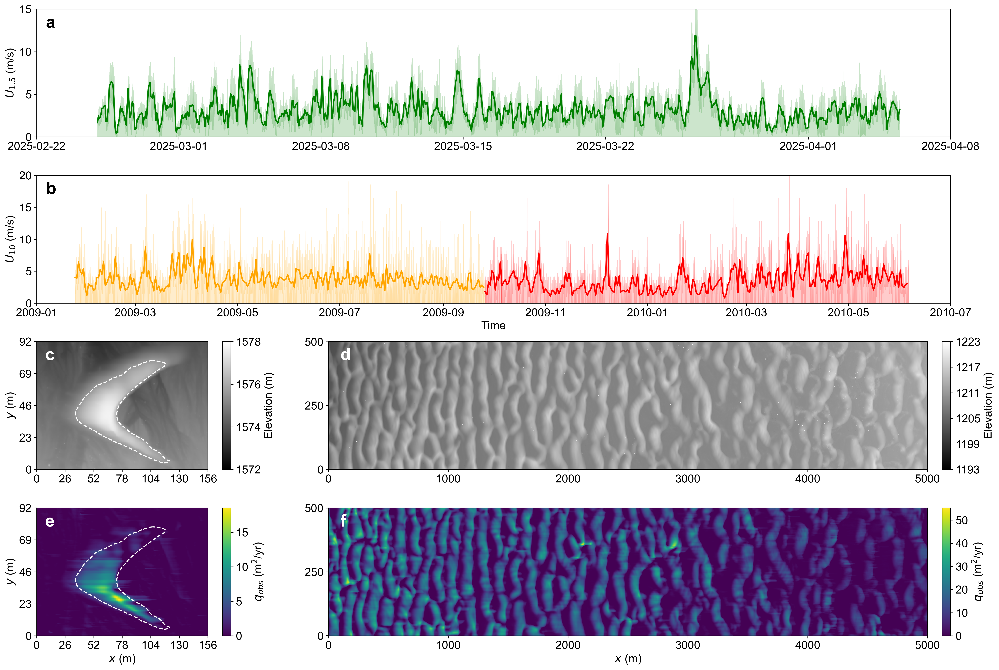

In [18]:
fontsize = 16
plt.rcParams.update({'font.size': fontsize})
fig = plt.figure(figsize=(24, 16))
gs = gridspec.GridSpec(
    4, 6,                
    width_ratios=[10, 0.5, 4, 35, 0.5, 1], 
    height_ratios=[1, 1,1,1],        
    wspace=0.1, hspace=0.3
)

ax_wind0=plt.subplot(gs[0, 0:5])
dw_hourly = dwtk_period0.resample('1h', on='time').mean().reset_index()
ax_wind0.plot(dw_hourly['time'], dw_hourly['speed'], color='green', lw=2)
ax_wind0.fill_between(dwtk_period0['time'], dwtk_period0['speed'],
                 color='green', alpha=0.2)
ax_wind0.set_xlim(pd.Timestamp('2025-02-22'), pd.Timestamp('2025-04-08'))
ax_wind0.set_ylim(0, 15)
ax_wind0.set_xlabel('')
ax_wind0.set_ylabel('$U_{1.5}$ (m/s)')



ax_wind1=plt.subplot(gs[1, 0:5])
ax_wind1.fill_between(dwws_df1['time'], dwws_df1['speed'], color='orange', alpha=0.2)
ax_wind1.plot(dwws_daily_df1['time'], dwws_daily_df1['speed'], color='orange', lw=2)
ax_wind1.fill_between(dwws_df2['time'], dwws_df2['speed'], color='red', alpha=0.2)
ax_wind1.plot(dwws_daily_df2['time'], dwws_daily_df2['speed'], color='red', lw=2)
ax_wind1.set_xlim(pd.Timestamp('2009-01-01'), pd.Timestamp('2010-07-01'))
ax_wind1.set_ylim(0, 20)
ax_wind1.set_xlabel('Time')
ax_wind1.set_ylabel('$U_{10}$ (m/s)')



ax0 = plt.subplot(gs[2, 0])
cx0 = plt.subplot(gs[2, 1])
im = ax0.pcolormesh(X, Y, np.flipud(dftk.z[0].T.values), cmap='grey',vmin=1572,vmax=1578)
plt.colorbar(im, cax=cx0,label='Elevation (m)')
ax0.set_xlabel('')
ax0.set_xlim(0,156)
ax0.set_xticks([0, 26, 52, 78, 104, 130, 156])
ax0.set_xticklabels([0, 26, 52, 78, 104, 130, 156])
ax0.set_ylabel('$y$ (m)')
ax0.set_ylim(0,92)
ax0.set_yticks([0, 23, 46, 69, 92])
ax0.set_yticklabels(['0', '23', '46', '69', '92'])



ax1 = plt.subplot(gs[2, 3])
cx1 = plt.subplot(gs[2, 4])
dfws.z[1].T.plot(ax=ax1, cmap='grey',cbar_ax=cx1,vmin=1193,vmax=1223,
                  cbar_kwargs={'ticks': np.linspace(1193, 1223, 6),'label': 'Elevation (m)'})
plt.title('')
ax1.set_xlim(0,5000)
ax1.set_xticks([0,1000, 2000, 3000, 4000, 5000])
ax1.set_xticklabels([0,1000, 2000, 3000, 4000, 5000])
ax1.set_xlabel('')
ax1.set_ylabel('')
ax1.set_title('')
ax1.set_yticks([0, 250, 500])
ax1.set_yticklabels(['0', '250', '500'])

ax2 = plt.subplot(gs[3, 0])
cx2 = plt.subplot(gs[3, 1])
im = ax2.pcolormesh(X, Y, np.flipud(dftk.qre[0].T.values), cmap='viridis')
cbar=plt.colorbar(im, cax=cx2,label='$q_{obs}$ (m$^{2}$/yr)')
ax2.set_xlabel('$x$ (m)')
ax2.set_xlim(0,156)
ax2.set_xticks([0, 26, 52, 78, 104, 130, 156])
ax2.set_xticklabels(['0', '26', '52', '78', '104', '130', '156'])
ax2.set_ylabel('$y$ (m)')
ax2.set_ylim(0,92)
ax2.set_yticks([0, 23, 46, 69, 92])
ax2.set_yticklabels(['0', '23', '46', '69', '92'])

ax3 = plt.subplot(gs[3, 3])
cx3 = plt.subplot(gs[3, 4])
dfws.qre[1].T.plot(ax=ax3, cmap='viridis',cbar_ax=cx3,vmin=0,
                  cbar_kwargs={'ticks': np.linspace(0, 60, 7),'label': '$q_{obs}$ (m$^{2}$/yr)'})
plt.title('')
ax3.set_xlim(0,5000)
ax3.set_yticks([0, 250, 500])
ax3.set_yticklabels(['0', '250', '500'])
ax3.set_xlabel('$x$ (m)')
ax3.set_ylabel('')
ax3.set_title('')

# contours
if contours:
    max_area = 0
    largest_contour = None
    
    for contour in contours:
        x_vals = contour[:, 1]
        y_vals = contour[:, 0]
        area = 0.5 * np.abs(np.dot(x_vals, np.roll(y_vals, 1)) - np.dot(y_vals, np.roll(x_vals, 1)))
        
        if area > max_area:
            max_area = area
            largest_contour = contour
    

    if largest_contour is not None:
        X = np.linspace(float(x[0]-xmin), float(x[-1]-xmin), dunemask_data.shape[1])
        Y = np.linspace(float(y[0]-ymin), float(y[-1]-ymin), dunemask_data.shape[0])
        
        x_pixels = largest_contour[:, 1]
        y_pixels = largest_contour[:, 0]
        
        x_contour = X[0] + x_pixels * (X[-1] - X[0]) / (dunemask_data.shape[1] - 1)
        y_contour = Y[0] + y_pixels * (Y[-1] - Y[0]) / (dunemask_data.shape[0] - 1)
        
        ax2.plot(x_contour, y_contour, 'w--', linewidth=1.5, label='Dune Boundary')
        ax0.plot(x_contour, y_contour, 'w--', linewidth=1.5, label='Dune Boundary')


ax_wind0.text(0.01, 0.95, "a", transform=ax_wind0.transAxes, fontsize=fs*3, fontweight='bold', va='top')
ax_wind1.text(0.01, 0.95, "b", transform=ax_wind1.transAxes, fontsize=fs*3, fontweight='bold', va='top')
ax0.text(0.05, 0.95, "c", transform=ax0.transAxes, fontsize=fs*3, fontweight='bold', va='top',color='w')
ax1.text(0.02, 0.95, "d", transform=ax1.transAxes, fontsize=fs*3, fontweight='bold', va='top',color='w')
ax2.text(0.05, 0.95, "e", transform=ax2.transAxes, fontsize=fs*3, fontweight='bold', va='top',color='w')
ax3.text(0.02, 0.95, "f", transform=ax3.transAxes, fontsize=fs*3, fontweight='bold', va='top',color='w')

# Figure 3

In [ ]:
# process DEM+wind data in the White Sands to get field-resolved wind and sediment flux
af0 = 25 # for white sands from Gunn et al. 2020
z01 = 10 # wind speed is measured at 10 m from KHMN station in the mestwest dataset
adelta = 15
dwws = pd.read_csv('/Users/ylin0188/Desktop/code box/dfsframework code/White Sands/Wind_White_Sands_KHMN.csv')
dwws['time'] = pd.to_datetime(dwws['time'])
dwws = dwws.set_index('time')
dwws = dwws.to_xarray()
dwws['direction_af0']=('time',bearing_2_pm180_af0(dwws['direction'],af0))
dwws['speed']=dwws['speed'].where(((dwws['direction_af0']<adelta) & (dwws['direction_af0']>-adelta)), other=0)
start_time = pd.Timestamp(dfws.t[1].item()).tz_localize('UTC')
end_time = pd.Timestamp(dfws.t[2].item()).tz_localize('UTC')

zdata=dfws.zre[1].values[3000:8000,:] # in order to save computational cost

dtws = xr.Dataset(data_vars=dict(z=(['x','y'],zdata)),
                coords=dict(x=(['x'],np.arange(zdata.shape[0])),
                            y=(['y'],np.arange(zdata.shape[1]))))

# use the represenstative/best values from the optimization method
ut = 0.29
Cq = 5
lsat = 1.7
padsl = -1/6
recth = np.tan(-18*np.pi/180)
recsl = -1/6

dtws = make_pad(dtws,'z','zp',padsl)
dtws= make_bubble(dtws,'zp','zb',recth,recsl)

dw_period1 = dwws.where((dwws.time >= start_time) & (dwws.time <= end_time) & (dwws.speed*kap/np.log(z01/z00) >=ut), drop=True)
dw_period1['stree_velocity'] = dw_period1['speed']*kap/np.log(z01/z00)

us=dw_period1['stree_velocity'].mean().item()#representative value e.g. mean value
dtws['uxso'] = (('x','y'),get_usxy_xy(get_taupxy_xy(dtws.x.data,dtws.y.data,dtws.zb.where(~dtws.zb.isnull(),dtws.zp).data,d,us,nu),us).real)
dtws['uxs'] = dtws.uxso.where(dtws.zb.isnull(),np.nan)
dtws['uyso'] = (('x','y'),get_usxy_xy(get_taupxy_xy(dtws.x.data,dtws.y.data,dtws.zb.where(~dtws.zb.isnull(),dtws.zp).data,d,us,nu),us).imag)
dtws['uys'] = dtws.uyso.where(dtws.zb.isnull(),np.nan)

dtws = dtws.assign_coords(time=dw_period1.time.data)
dtws['ux'] = (('time'),dw_period1['stree_velocity'].data)
dtws['uxt'] = dtws.ux/us*dtws.uxs
dtws['uxspt'] = dtws.uxt.mean('time')
dtws['qs'] = (dtws.uxt**2-ut**2)*Cq*ut*rhof/rhos*grav
dtws['qs'] = dtws.qs.where(dtws.qs>0,0)
dtws['qsat'] = dtws.qs.mean('time') * 365.25 * 24

q = np.zeros(dtws.qs.shape) # true flux array initialised
q[:,0] = 0 # input true flux at x=0, here just arbitrary
dx=dtws.x.isel(x=slice(None,2)).diff('x').data[0]
for i in range(1,q.shape[1]):
    q[:,i] = (q[:,i-1]+dx*dtws.qs.data[:,i]/lsat)/(1+dx/lsat) # loop through and make true flux
dtws['q'] = (('time','x','y'),q)
dtws['qspt'] = dtws.q.mean('time') * 365.25 * 24

In [21]:
start_time = pd.Timestamp(dftk.t[0].item()).tz_localize('UTC')
end_time = pd.Timestamp(dftk.t[1].item()).tz_localize('UTC')

dttk = xr.Dataset(
    {
        'z': (('x', 'y'),dftk.dunemask.isel(t=0).fillna(0).values)
    },
    coords={
        'x': (('x'), dftk.x.values - dftk.x.min().item()),
        'y': (('y'), dftk.y.values - dftk.y.min().item()),
    },
)

dttk = make_pad(dttk,'z','zp',padsl)
dttk= make_bubble(dttk,'zp','zb',recth,recsl)
dttk['zpb'] = xr.where(dttk.zb.isnull(), dttk.zp, dttk.zb)
dttk['zpbro'] = dttk.zpb-dttk.zp+dttk.z
qdata=dftk.qmask[0].values
qdem = np.zeros(dttk.z.shape)
x_offset = (dttk.x.size- qdata.shape[0]) // 2
y_offset = (dttk.y.size- qdata.shape[1]) // 2
qdem[x_offset:x_offset + qdata.shape[0], y_offset:y_offset + qdata.shape[1]] = qdata
dttk['qdem'] = (('x','y'),qdem)

ut = 0.293
Cq = 6.4
lsat = 0.7
z01=1.5
dw_period1 = dwtk.where((dwtk.time >= start_time) & (dwtk.time <= end_time) & (dwtk.speed*kap/np.log(z01/z00) >=ut))
dw_period1['stree_velocity'] = dw_period1['speed']*kap/np.log(z01/z00)
dw_period1 = dw_period1.dropna()

us=dw_period1['stree_velocity'].mean().item()#representative value
dttk['uxso'] = (('x','y'),get_usxy_xy(get_taupxy_xy(dttk.x.data,dttk.y.data,dttk.zb.where(~dttk.zb.isnull(),dttk.zp).data,d,us,nu),us).real)
dttk['uxs'] = dttk.uxso.where(dttk.zb.isnull(),np.nan)
dttk['uyso'] = (('x','y'),get_usxy_xy(get_taupxy_xy(dttk.x.data,dttk.y.data,dttk.zb.where(~dttk.zb.isnull(),dttk.zp).data,d,us,nu),us).imag)
dttk['uys'] = dttk.uyso.where(dttk.zb.isnull(),np.nan)


dttk = dttk.assign_coords(time=dw_period1.time)
dttk['ux'] = (('time'),dw_period1['stree_velocity'])
dttk['uxt'] = dttk.ux/us*dttk.uxs
dttk['qs'] = (dttk.uxt**2-ut**2)*Cq*ut*rhof/rhos*grav
dttk['qs'] = dttk.qs.where(dttk.qs>0,0)
dttk['qsat'] = dttk.qs.mean('time') * 365.25 * 24

dx = dttk.x.isel(x=slice(None,2)).diff('x').data[0]

q = np.zeros(dttk.qs.shape) # true flux array initialised
q[:,0] = 0 # input true flux at x=0, here just arbitrary
dx=dttk.x.isel(x=slice(None,2)).diff('x').data[0]
for i in range(1,q.shape[1]):
    q[:,i] = (q[:,i-1]+dx*dttk.qs.data[:,i]/lsat)/(1+dx/lsat) # loop through and make true flux
dttk['q'] = (('time','x','y'),q)
dttk['qspt'] = dttk.q.mean('time') * 365.25 * 24

Text(0.01, 0.95, 'f')

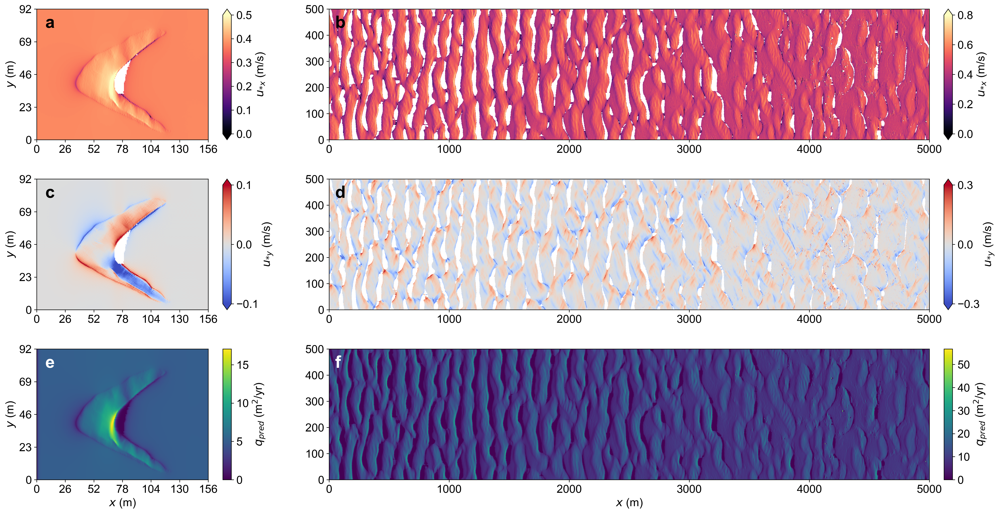

In [22]:
fig = plt.figure(figsize=(24,12))
gs = gridspec.GridSpec(
    3, 6,                
    width_ratios=[10, 0.5, 4, 35, 0.5, 1], 
    height_ratios=[1, 1, 1],        
    wspace=0.1, hspace=0.3 
)

ax0 = plt.subplot(gs[0, 0])
cx0 = plt.subplot(gs[0, 1])
im = ax0.pcolormesh(X, Y, np.flipud(dttk.uxs.T.values), cmap='magma',vmax=0.5,vmin=0)
cbar=plt.colorbar(im, cax=cx0,label='$u_{*x}$ (m/s)',extend='both')
cbar.set_ticks(np.linspace(0, 0.5, 6))
ax0.set_xlim(0,156)
ax0.set_xticks([0, 26, 52, 78, 104, 130, 156])
ax0.set_xticklabels(['0', '26', '52', '78', '104', '130', '156'])
ax0.set_xlabel('')
ax0.set_ylabel('$y$ (m)')
ax0.set_ylim(0,92)
ax0.set_yticks([0, 23, 46, 69, 92])
ax0.set_yticklabels(['0', '23', '46', '69', '92'])


ax1 = plt.subplot(gs[0, 3])
cx1 = plt.subplot(gs[0, 4])
dtws.uxs[int((dtws.uxspt.shape[0]-5000)/2):int((dtws.uxspt.shape[0]-5000)/2+5000)
        ,int((dtws.uxspt.shape[1]-500)/2):int((dtws.uxspt.shape[1]-500)/2+500)].T.plot(ax=ax1, cmap='magma',cbar_ax=cx1,vmin=0,vmax=0.8,
                                                                                       cbar_kwargs={'ticks': np.linspace(0, 0.8, 5),'label': '$u_{*x}$ (m/s)'})
plt.title('')
ax1.set_xlim(0,5000)
ax1.set_xticks([0, 1000, 2000, 3000, 4000, 5000])
ax1.set_xticklabels([0, 1000, 2000, 3000, 4000, 5000])
ax1.set_ylim(0,500)
ax1.set_xlabel('')
ax1.set_ylabel('')
ax1.set_title('')

ax2 = plt.subplot(gs[1, 0])
cx2 = plt.subplot(gs[1, 1])
im = ax2.pcolormesh(X, Y, np.flipud(dttk.uys.T.values), cmap='coolwarm',vmin=-0.1,vmax=0.1)
cbar=plt.colorbar(im, cax=cx2,label='$u_{*y}$ (m/s)',extend='both') 
cbar.set_ticks(np.linspace(-0.1, 0.1, 3))
ax2.set_xlim(0,156)
ax2.set_xticks([0, 26, 52, 78, 104, 130, 156])
ax2.set_xticklabels(['0', '26', '52', '78', '104', '130', '156'])
ax2.set_xlabel('')
ax2.set_ylabel('$y$ (m)')
ax2.set_ylim(0,92)
ax2.set_yticks([0, 23, 46, 69, 92])
ax2.set_yticklabels(['0', '23', '46', '69', '92'])

ax3 = plt.subplot(gs[1, 3])
cx3 = plt.subplot(gs[1, 4])
dtws.uys[int((dtws.uxspt.shape[0]-5000)/2):int((dtws.uxspt.shape[0]-5000)/2+5000)
        ,int((dtws.uxspt.shape[1]-500)/2):int((dtws.uxspt.shape[1]-500)/2+500)].T.plot(ax=ax3, cmap='coolwarm',cbar_ax=cx3,vmin=-0.3,vmax=0.3,
                                                                                       cbar_kwargs={'ticks': np.linspace(-0.3,0.3 , 3),'label': '$u_{*y}$ (m/s)'})
plt.title('')
ax3.set_xlim(0,5000)
ax3.set_xticks([0, 1000, 2000, 3000, 4000, 5000])
ax3.set_xticklabels([0, 1000, 2000, 3000, 4000, 5000])
ax3.set_ylim(0,500)
ax3.set_xlabel('')
ax3.set_ylabel('')
ax3.set_title('')

ax4 = plt.subplot(gs[2, 0])
cx4 = plt.subplot(gs[2, 1])
im = ax4.pcolormesh(X, Y, np.flipud(dttk.qspt.T.values), cmap='viridis')
cbar=plt.colorbar(im, cax=cx4,label='$q_{pred}$ (m$^{2}$/yr)')
ax4.set_xlim(0,156)
ax4.set_xticks([0, 26, 52, 78, 104, 130, 156])
ax4.set_xticklabels(['0', '26', '52', '78', '104', '130', '156'])
ax4.set_xlabel('$x$ (m)')
ax4.set_ylabel('$y$ (m)')
ax4.set_ylim(0,92)
ax4.set_yticks([0, 23, 46, 69, 92])
ax4.set_yticklabels(['0', '23', '46', '69', '92'])

ax5 = plt.subplot(gs[2, 3])
cx5 = plt.subplot(gs[2, 4])
dtws.qspt[int((dtws.uxspt.shape[0]-5000)/2):int((dtws.uxspt.shape[0]-5000)/2+5000)
        ,int((dtws.uxspt.shape[1]-500)/2):int((dtws.uxspt.shape[1]-500)/2+500)].T.plot(ax=ax5, cmap='viridis',cbar_ax=cx5,vmin=0,
                                                                                       cbar_kwargs={'ticks': np.linspace(0, 60, 7),'label': '$q_{pred}$ (m$^{2}$/yr)'})
plt.title('')
ax5.set_xlim(0,5000)
ax5.set_ylim(0,500)
ax5.set_xlabel('$x$ (m)')
ax5.set_ylabel('')
ax5.set_title('')

ax0.text(0.05, 0.95, "a", transform=ax0.transAxes, fontsize=fs*3, fontweight='bold', va='top')
ax1.text(0.01, 0.95, "b", transform=ax1.transAxes, fontsize=fs*3, fontweight='bold', va='top')
ax2.text(0.05, 0.95, "c", transform=ax2.transAxes, fontsize=fs*3, fontweight='bold', va='top')
ax3.text(0.01, 0.95, "d", transform=ax3.transAxes, fontsize=fs*3, fontweight='bold', va='top')
ax4.text(0.05, 0.95, "e", transform=ax4.transAxes, fontsize=fs*3, fontweight='bold', va='top',color='w')
ax5.text(0.01, 0.95, "f", transform=ax5.transAxes, fontsize=fs*3, fontweight='bold', va='top',color='w')

# Figure 4

## For the barchan dune in Taklamakan

In [42]:
def fromfactor_tolossfunction(ut,Cq,lsat,dt,dw,z01,start_time,end_time):
    dw_period = dw.where((dw.time >= start_time) & (dw.time <= end_time) & (dw.speed*kap/np.log(z01/z00) >=ut))
    dw_period['stree_velocity'] = dw_period['speed']*kap/np.log(z01/z00)
    dw_period = dw_period.dropna()

    us=dw_period['stree_velocity'].mean().item()#representative value
    dt['uxs'] = (('x','y'),get_usxy_xy(get_taupxy_xy(dt.x.data,dt.y.data,dt.zb.where(~dt.zb.isnull(),dt.zp).data,d,us,nu),us).real)
    dt['uxs'] = dt.uxs.where(dt.zb.isnull(),0).clip(0,None)


    dt = dt.assign_coords(time=dw_period.time)
    dt['ux'] = (('time'),dw_period['stree_velocity'])
    dt['uxt'] = dt.ux/us*dt.uxs
    dt['qs'] = (dt.uxt**2-ut**2)*Cq*ut*rhof/rhos*grav
    dt['qs'] = dt.qs.where(dt.qs>0,0)

    dx = dt.x.isel(x=slice(None,2)).diff('x').data[0]

    q = np.zeros(dt.qs.shape) # true flux array initialised
    q[:,0] = 0 # input true flux at x=0, here just arbitrary
    dx=dt.x.isel(x=slice(None,2)).diff('x').data[0]
    for i in range(1,q.shape[1]):
        q[:,i] = (q[:,i-1]+dx*dt.qs.data[:,i]/lsat)/(1+dx/lsat) # loop through and make true flux
    dt['q'] = (('time','x','y'),q)
    dt['qspt'] = dt.q.mean('time') * 365.25 * 24

    q_spt=[]
    q_dem=[]

    for y_disp in range(dftk.y.shape[0]):
        z_y=dt.z[:,y_disp]   
        qspt_y=dt.qspt[:,y_disp]
        qdem_y=dt.qdem[:,y_disp]

        if z_y.max()>0:

            q_spt.append(qspt_y[z_y ==z_y.max().values])
            q_dem.append(qdem_y[z_y ==z_y.max().values])

    q_spt = np.array(q_spt, dtype=np.float64).flatten()
    q_dem = np.array(q_dem, dtype=np.float64).flatten()
    invalid_indices = (q_dem<=0) | (q_spt<=0)
    q_dem = q_dem[~invalid_indices]
    q_spt = q_spt[~invalid_indices]

    return(np.mean(np.abs(q_dem-q_spt)))

In [123]:
d_tk=180 # Gao et al. 2021
rhos_tk=2550 # Gao et al. 2021
dttk = xr.Dataset(
    {
        'z': (('x', 'y'),dftk.dunemask.isel(t=0).fillna(0).values)
    },
    coords={
        'x': (('x'), dftk.x.values - dftk.x.min().item()),
        'y': (('y'), dftk.y.values - dftk.y.min().item()),
    },
)

dttk = make_pad(dttk,'z','zp',padsl)
dttk= make_bubble(dttk,'zp','zb',recth,recsl)
dttk['zpb'] = xr.where(dttk.zb.isnull(), dttk.zp, dttk.zb)
dttk['zpbro'] = dttk.zpb-dttk.zp+dttk.z

qdata=dftk.qmask[0].values
qdem = np.zeros(dttk.z.shape)
x_offset = (dttk.x.size- qdata.shape[0]) // 2
y_offset = (dttk.y.size- qdata.shape[1]) // 2
qdem[x_offset:x_offset + qdata.shape[0], y_offset:y_offset + qdata.shape[1]] = qdata
dttk['qdem'] = (('x','y'),qdem)

start_time = pd.Timestamp(dftk.t[0].item()).tz_localize('UTC')
end_time = pd.Timestamp(dftk.t[1].item()).tz_localize('UTC')


In [44]:
def objective(params):
    ut, Cq ,lsat= params
    return fromfactor_tolossfunction(ut,Cq,lsat,dttk,dwtk,z01,start_time,end_time)


x0 = [0.25,6.4,0.7]  

# bounds
bounds = [(0.2, 0.4),  # uth range
        (2, 8), # Cq range
        (0,1)]  # lsat range

res_tk = minimize(objective, x0, method='L-BFGS-B',bounds=bounds)

print("Optimization Results:")
print("uth =", res_tk.x[0])
print("Cq   =", res_tk.x[1])
print("lsat   =", res_tk.x[2])

Optimization Results:
uth = 0.25395911699701385
Cq   = 6.4031099411409
lsat   = 0.6975805578781974


In [45]:
Cq_vals_tk_forCq= np.linspace(2, 8, 100)
loss_gridCq_tk = np.zeros(len(Cq_vals_tk_forCq))
for i, Cq in enumerate(Cq_vals_tk_forCq):
    loss_gridCq_tk[i] = fromfactor_tolossfunction(res_tk.x[0],Cq,res_tk.x[2],dttk,dwtk,z01,start_time,end_time)
    print(f"Cq: {Cq:.2f}", end='\r')

In [46]:
lsat_vals_tkforCl = np.linspace(1, 5, 100)/(rhof/(rhos_tk*d_tk*1e-6))
loss_gridlsat_tk = np.zeros(len(lsat_vals_tkforCl))

for j, lsat in enumerate(lsat_vals_tkforCl):
    loss_gridlsat_tk[j] = fromfactor_tolossfunction(res_tk.x[0],res_tk.x[1],lsat,dttk,dwtk,z01,start_time,end_time)
    print(f"lsat: {lsat:.2f}", end='\r')

In [47]:
uth_vals_tkforCu = np.linspace(0.05,0.2,14)/np.sqrt(rhof/(rhos_tk*grav*d_tk*1e-6))
loss_griduth_tk = np.zeros(len(uth_vals_tkforCu))
lsat_mf = lsat_vals_tkforCl[np.log(loss_gridlsat_tk/np.min(loss_gridlsat_tk))==0]

for j, uth in enumerate(uth_vals_tkforCu):
    loss_griduth_tk[j] = fromfactor_tolossfunction(uth,res_tk.x[1],lsat_mf,dttk,dwtk,z01,start_time,end_time)
    print(f"uth: {uth:.2f}", end='\r')

In [48]:
Cq_vals_tk_2d = np.linspace(2, 8, 15)    
Cut_vals_tk_2d = np.linspace(0.05,0.2,15)
loss_grid_tk2d = np.zeros((len(Cut_vals_tk_2d), len(Cq_vals_tk_2d)))

for i, Cut in enumerate(Cut_vals_tk_2d):
    for j, Cq in enumerate(Cq_vals_tk_2d):
        loss_grid_tk2d[i, j] = fromfactor_tolossfunction(Cut/np.sqrt(rhof/(rhos_tk*grav*d_tk*1e-6)),Cq,res_tk.x[2],dttk,dwtk,z01,start_time,end_time)
        print(f"Cut: {Cut:.2f}, Cq: {Cq:.2f}", end='\r')

In [124]:
Cq_vals_tk = np.linspace(2, 8, 10)
Cut_vals_tk = np.linspace(0.05,0.2,10)
Clsat_vals_tk = np.linspace(1,5,10)

loss_grid_tk3d = np.zeros((len(Cq_vals_tk), len(Cut_vals_tk), len(Clsat_vals_tk)))

for i, Cq in enumerate(Cq_vals_tk):
    for j, Cut in enumerate(Cut_vals_tk):
            for k, Clsat in enumerate(Clsat_vals_tk):
                loss_grid_tk3d[i, j, k] = fromfactor_tolossfunction(Cut/np.sqrt(rhof/(rhos_tk*grav*d_tk*1e-6)),Cq,Clsat/(rhof/(rhos_tk*d_tk*1e-6)),dttk,dwtk,z01,start_time,end_time)
                print(f"Cq: {Cq:.2f}, Cut: {Cut:.2f}, Clast: {Clsat:.2f} ", end='\r')

## For the White Sands Dune Field Period 1

In [50]:
def fromfactor_tolossfunction_ws(ut,Cq,lsat,dt,dw,start_time,end_time):

    dw_period1 = dw.where((dw.time >= start_time) & (dw.time <= end_time) & (dw.speed*kap/np.log(10/z00) >=ut), drop=True)
    # dw_period1 = dw.where((dw.time >= start_time) & (dw.time <= end_time) & (dw.speed!=0) , drop=True)
    dw_period1['stree_velocity'] = dw_period1['speed']*kap/np.log(10/z00)

    us=dw_period1['stree_velocity'].mean().item()#representative value
    dt['uxs'] = (('x','y'),get_usxy_xy(get_taupxy_xy(dt.x.data,dt.y.data,dt.zb.where(~dt.zb.isnull(),dt.zp).data,d,us,nu),us).real)
    dt['uxs'] = dt.uxs.where(dt.zb.isnull(),0).clip(0,None)


    dt = dt.assign_coords(time=dw_period1.time.data)
    dt['ux'] = (('time'),dw_period1['stree_velocity'].data)
    dt['uxt'] = dt.ux/us*dt.uxs
    dt['qs'] = (dt.uxt**2-ut**2)*Cq*ut*rhof/rhos*grav
    dt['qs'] = dt.qs.where(dt.qs>0,0)

    dx = dt.x.isel(x=slice(None,2)).diff('x').data[0]

    q = np.zeros(dt.qs.shape) # true flux array initialised
    q[:,0] = 0 # input true flux at x=0, here just arbitrary
    dx=dt.x.isel(x=slice(None,2)).diff('x').data[0]
    for i in range(1,q.shape[1]):
        q[:,i] = (q[:,i-1]+dx*dt.qs.data[:,i]/lsat)/(1+dx/lsat) # loop through and make true flux
    dt['q'] = (('time','x','y'),q)
    dt['qspt'] = dt.q.mean('time') * 365.25 * 24


    q_spt=[]
    q_dem=[]


    for y_disp in range((dt.y.size-501)//2, (dt.y.size-501)//2+501):
        z_y=dt.z[(dt.x.size-1500)//2:(dt.x.size-1500)//2+1500,y_disp]
        qspt_y=dt.qspt[(dt.x.size-1500)//2:(dt.x.size-1500)//2+1500,y_disp]
        qdem_y=dt.qdem[(dt.x.size-1500)//2:(dt.x.size-1500)//2+1500,y_disp]

        #find valleys to divide 2D dune profile into segments 
        peaks, properties = find_peaks(-z_y, prominence=0.5, distance=80)
        del properties
        valley_pos = peaks[z_y[peaks] < 3]
        del peaks

        # find qcrest of dem and spt(fft)
        for x_disp in range(1,len(valley_pos)):
            startIDx=valley_pos[x_disp-1]
            endIDx=valley_pos[x_disp]
            segment_z=z_y[startIDx:endIDx]
            segment_qspt=qspt_y[startIDx:endIDx]
            segment_qdem=qdem_y[startIDx:endIDx]

            q_spt.append(segment_qspt[segment_z.values ==segment_z.max().values])
            q_dem.append(segment_qdem[segment_z.values ==segment_z.max().values])




    q_spt = np.array(q_spt, dtype=np.float64).flatten()
    q_dem = np.array(q_dem, dtype=np.float64).flatten()

    # return(np.mean(np.abs(q_dem/q_spt-1)))
    return(np.mean(np.abs(q_dem-q_spt)))

In [51]:
d_ws=400 # Jerolmack et al. 2011 (White Sands)
start_time = pd.Timestamp(dfws.t[0].item()).tz_localize('UTC')
end_time = pd.Timestamp(dfws.t[1].item()).tz_localize('UTC')

zdata=dfws.zre[0].values[3000:4500,:]
dt = xr.Dataset(data_vars=dict(z=(['x','y'],zdata)),
                coords=dict(x=(['x'],np.arange(zdata.shape[0])),
                            y=(['y'],np.arange(zdata.shape[1]))))

dt = make_pad(dt,'z','zp',padsl)
dt = make_bubble(dt,'zp','zb',recth,recsl)
qdata=dfws.qre[0].values[3000:4500,:]
qdem = np.zeros(dt.z.shape)
x_offset = (dt.x.size- qdata.shape[0]) // 2
y_offset = (dt.y.size- qdata.shape[1]) // 2
qdem[x_offset:x_offset + qdata.shape[0], y_offset:y_offset + qdata.shape[1]] = qdata
dt['qdem'] = (('x','y'),qdem)

In [ ]:
# # This block will cost more than 30 minutes to run using Apple M4, so we save the results and use/load it directly. 
# def objective(params):
#     ut, Cq,lsat = params
#     return fromfactor_tolossfunction_ws(ut,Cq,lsat,dt,dwws,start_time,end_time)


# # x0 = [0.32,6,1.7]

# x0 = [0.325,5,1.7]  

# # bounds
# bounds = [(0.2, 0.4),  # uth range
#         (2, 8), # Cq range
#         (1.5,2)]  # Clsat range

# res0 = minimize(objective, x0, method='L-BFGS-B',bounds=bounds)
# np.savez('/Users/ylin0188/Desktop/code box/dfsframework code/White Sands/optimazation_WS_P0.npz',res0)

data = np.load('/Users/ylin0188/Desktop/code box/dfsframework code/White Sands/optimazation_WS_P0.npz', allow_pickle=True)
res0= data['arr_0'].item()
del data

print("Optimazation Results:")
print("uth =", res0.x[0])
print("Cq   =", res0.x[1])
print("lsat   =", res0.x[2])

Optimazation Results:
uth = 0.320509368192641
Cq   = 5.016143477651839
lsat   = 1.709033009466194


In [53]:
lsat_vals_ws0 = np.linspace(1, 5, 48)/(rhof/(rhos*d_ws*1e-6))
loss_gridlsat_ws0 = np.zeros(len(lsat_vals_ws0))

for j, lsat in enumerate(lsat_vals_ws0):
    loss_gridlsat_ws0[j] = fromfactor_tolossfunction_ws(round(res0.x[0], 2),res0.x[1],lsat,dt,dwws,start_time,end_time)
    print(f"lsat: {lsat:.2f}", end='\r')

In [54]:
uth_val_ws0 = np.linspace(0.05, 0.2, 10)/np.sqrt(rhof/(rhos*grav*d_ws*1e-6))
loss_griduth_ws0 = np.zeros(len(uth_val_ws0))
lsat_ws0 =lsat_vals_ws0[np.log(loss_gridlsat_ws0/np.min(loss_gridlsat_ws0))==0]

for j, uth in enumerate(uth_val_ws0):
    loss_griduth_ws0[j] = fromfactor_tolossfunction_ws(uth,res0.x[1],lsat_ws0,dt,dwws,start_time,end_time)
    print(f"uth: {uth:.2f}", end='\r')


In [55]:
Cq_vals_ws0 = np.linspace(2,8,50)
loss_gridCq_ws0 = np.zeros(len(Cq_vals_ws0))

for i, Cq in enumerate(Cq_vals_ws0):
    loss_gridCq_ws0[i] = fromfactor_tolossfunction_ws(res0.x[0],Cq,res0.x[2],dt,dwws,start_time,end_time)
    print(f"Cq: {Cq:.2f}", end='\r')

In [56]:
Cut_vals_ws2D = np.linspace(0.05,0.2,10)  
Cq_vals_ws2D = np.linspace(2, 8, 15) 
loss_grid2D_ws0 = np.zeros((len(Cut_vals_ws2D), len(Cq_vals_ws2D)))

for i, Cut in enumerate(Cut_vals_ws2D):
    for j, Cq in enumerate(Cq_vals_ws2D):
        loss_grid2D_ws0[i, j] = fromfactor_tolossfunction_ws(Cut/np.sqrt(rhof/(rhos*grav*d_ws*1e-6)),Cq,round(res0.x[2],1),dt,dwws,start_time,end_time)
        print(f"Csat: {Cut:.2f}, Cq: {Cq:.2f}", end='\r')

## For the White Sands Dune Field Period 2

In [57]:
start_time = pd.Timestamp(dfws.t[1].item()).tz_localize('UTC')
end_time = pd.Timestamp(dfws.t[2].item()).tz_localize('UTC')

zdata=dfws.zre[1].values[3000:4500,:]
dt = xr.Dataset(data_vars=dict(z=(['x','y'],zdata)),
                coords=dict(x=(['x'],np.arange(zdata.shape[0])),
                            y=(['y'],np.arange(zdata.shape[1]))))

dt = make_pad(dt,'z','zp',padsl)
dt = make_bubble(dt,'zp','zb',recth,recsl)
qdata=dfws.qre[1].values[3000:4500,:]
qdem = np.zeros(dt.z.shape)
x_offset = (dt.x.size- qdata.shape[0]) // 2
y_offset = (dt.y.size- qdata.shape[1]) // 2
qdem[x_offset:x_offset + qdata.shape[0], y_offset:y_offset + qdata.shape[1]] = qdata
dt['qdem'] = (('x','y'),qdem)

In [ ]:
# # This block will cost ~20 minutes to run using Apple M4, so we save the results and use/load it directly. 
# def objective(params):
#     ut, Cq ,lsat= params
#     return fromfactor_tolossfunction_ws(ut,Cq,lsat,dt,dwws,start_time,end_time)


# x0 = [0.32,5,1.7]  

# # bounds
# bounds = [(0.2, 0.4),  # uth range
#         (2, 8),
#         (1.5,2)]  # Klsat range



# res1 = minimize(objective, x0, method='L-BFGS-B',bounds=bounds)

# np.savez('/Users/ylin0188/Desktop/code box/dfsframework code/White Sands/optimazation_WS_P1.npz',res1)

data = np.load('/Users/ylin0188/Desktop/code box/dfsframework code/White Sands/optimazation_WS_P0.npz', allow_pickle=True)
res1= data['arr_0'].item()
del data

print("Optimazation Results:")
print("uth =", res1.x[0])
print("Cq   =", res1.x[1])
print("lsat   =", res1.x[2])

Optimazation Results:
uth = 0.29781530308650744
Cq   = 4.787250036670259
lsat   = 1.7340519678898538


In [59]:
lsat_vals_ws1 =  np.linspace(0.5, 6, 52)        
loss_gridlsat_ws1 = np.zeros(len(lsat_vals_ws1))

for j, lsat in enumerate(lsat_vals_ws1):
    loss_gridlsat_ws1[j] = fromfactor_tolossfunction_ws(res1.x[0]//0.001/1000,res1.x[1],lsat,dt,dwws,start_time,end_time)
    print(f"lsat: {lsat:.2f}", end='\r')



In [60]:
Cq_vals_ws1 = np.linspace(2, 8, 45)
loss_gridCq_ws1 = np.zeros(len(Cq_vals_ws1))

for i, Cq in enumerate(Cq_vals_ws1):
    loss_gridCq_ws1[i] = fromfactor_tolossfunction_ws(res1.x[0],Cq,res1.x[2],dt,dwws,start_time,end_time)
    print(f"Cq: {Cq:.2f}", end='\r')

In [61]:
uth_val_ws1 = np.linspace(0.05, 0.20, 12)/np.sqrt(rhof/(rhos*grav*d_ws*1e-6))   
loss_griduth_ws1 = np.zeros(len(uth_val_ws1))
lsat_ws1 =lsat_vals_ws1[np.log(loss_gridlsat_ws1/np.min(loss_gridlsat_ws1))==0]

for j, uth in enumerate(uth_val_ws1):
    loss_griduth_ws1[j] = fromfactor_tolossfunction_ws(uth,res1.x[1],lsat_ws1,dt,dwws,start_time,end_time)
    print(f"uth: {uth:.2f}", end='\r')

In [62]:
Cut_vals_ws2D = np.linspace(0.05,0.2,10)  
Cq_vals_ws2D = np.linspace(2, 8, 15) 
loss_grid2D_ws1 = np.zeros((len(Cut_vals_ws2D), len(Cq_vals_ws2D)))

for i, Cut in enumerate(Cut_vals_ws2D):
    for j, Cq in enumerate(Cq_vals_ws2D):
        loss_grid2D_ws1[i, j] = fromfactor_tolossfunction_ws(Cut/np.sqrt(rhof/(rhos*grav*d_ws*1e-6)),Cq,round(res1.x[2],1),dt,dwws,start_time,end_time)
        print(f"Csat: {Cut:.2f}, Cq: {Cq:.2f}", end='\r')

In [ ]:
# it will take more than 2 hours (apple M4) to run the 3D grid of loss function values of two WS cases, so i save the results to a .npz file
Cq_vals_ws = np.linspace(2, 8, 10)
Cut_vals_ws = np.linspace(0.05,0.2,10)
Clsat_vals_ws = np.linspace(1,5,10)
loss_data = np.load('/Users/ylin0188/Desktop/code box/dfsframework code/White Sands/loss_grid_3D_forWS.npz', allow_pickle=True)
loss_grid_ws13d= loss_data['loss_grid_ws13d']
loss_grid_ws03d= loss_data['loss_grid_ws03d']

Text(0.05, 0.95, 'd')

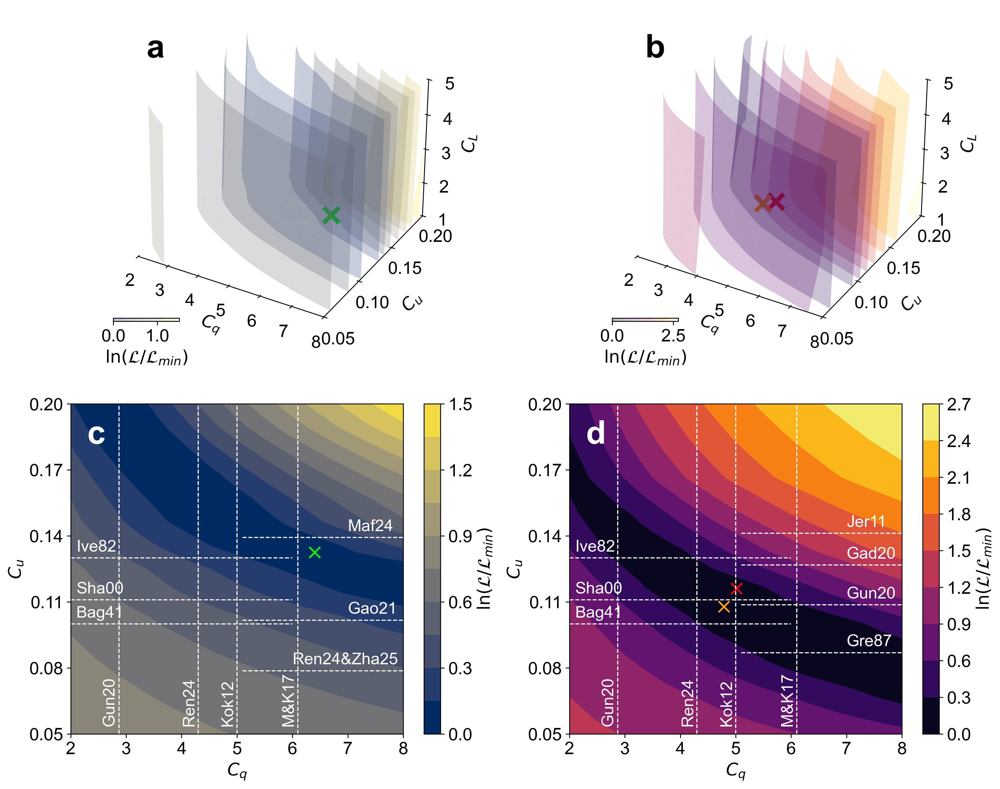

In [188]:
fs=10
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(15, 12))
plt.rcParams['font.size'] = 16 # standard font size

ngrid = 100 # higher resolution interpolation of normalised loss
nlevels = 8
lossinterp = RegularGridInterpolator((Cq_vals_tk,Cut_vals_tk,Clsat_vals_tk),np.log(loss_grid_mf3d/np.min(loss_grid_mf3d)),method='cubic') # make interpolator function
Clinterp,Cuinterp,Ckinterp = np.linspace(Cq_vals_tk[0],Cq_vals_tk[-1],ngrid),np.linspace(Cut_vals_tk[0],Cut_vals_tk[-1],ngrid),np.linspace(Clsat_vals_tk[0],Clsat_vals_tk[-1],ngrid) # make higher resolution axes
lossinterp = lossinterp(np.meshgrid(Clinterp,Cuinterp,Ckinterp,indexing='ij')) # overwrite function with higher resolution interpolated normalised loss array
lossinterp -= lossinterp.min() # because of cubic interpolation, the minimum will no longer be 'zero', offset it


levels = np.linspace(0,np.floor(lossinterp.max()*(nlevels-1))/(nlevels-1),nlevels)
cmapname = 'cividis'
cmap = mpl.colormaps[cmapname]
colors = cmap(np.linspace(0,1,nlevels))

ax[0,0].remove()
ax[0,0] = fig.add_subplot(2, 2, 1, projection='3d')
for i in range(nlevels):
    verts,faces,_,_ = marching_cubes(lossinterp,spacing=(Clinterp[1]-Clinterp[0],Cuinterp[1]-Cuinterp[0],Ckinterp[1]-Ckinterp[0]),level=levels[i])
    verts[:, 0] = Clinterp[0] + verts[:, 0]
    verts[:, 1] = Cuinterp[0] + verts[:, 1]
    verts[:, 2] = Ckinterp[0] + verts[:, 2]
    mesh = Poly3DCollection(verts[faces],linewidth=0,color=colors[i],alpha=.25)
    ax[0,0].add_collection3d(mesh)
ax[0,0].set_xlabel('$C_{q}$')
ax[0,0].set_ylabel('$C_{u}$',labelpad=10)
ax[0,0].set_zlabel('$C_{L}$')
ax[0,0].set_xlim(Clinterp[0], Clinterp[-1])
ax[0,0].set_ylim(Cuinterp[0], Cuinterp[-1])
ax[0,0].set_zlim(Ckinterp[0], Ckinterp[-1])
ax[0,0].set_yticks(np.linspace(Cuinterp[0], Cuinterp[-1],4))
ax[0,0].set_zticks(np.linspace(Ckinterp[0], Ckinterp[-1],5))


# ax[0,0].set_yticklabels([0.08,0.13,0.18])
ax[0,0].xaxis.pane.fill = False
ax[0,0].yaxis.pane.fill = False
ax[0,0].zaxis.pane.fill = False
ax[0,0].xaxis.pane.set_edgecolor('w')
ax[0,0].yaxis.pane.set_edgecolor('w')
ax[0,0].zaxis.pane.set_edgecolor('w')
ax[0,0].grid(False)
pcm = ax[0,0].scatter(0,0,s=0,c=0,vmin=levels[0],vmax=1.5,cmap=cmapname)
cax = ax[0,0].inset_axes([0,0.05,0.2,0.01], transform=ax[0,0].transAxes)
cbar = plt.colorbar(pcm, cax=cax, orientation='horizontal',shrink=.05)
cbar.solids.set_alpha(0.25)
cbar.ax.xaxis.set_major_formatter(FormatStrFormatter('%.1f'))
cbar.ax.set_xlabel('$\\ln(\\mathcal{L}/\\mathcal{L}_{min})$')
ax[0,0].scatter(res_tk.x[1],res_tk.x[0]*np.sqrt(rhof/(rhos_tk*grav*d_tk*1e-6)), res_tk.x[2]*(rhof/(rhos_tk*d_tk*1e-6)), color='#00FF00',marker='x', s=200,linewidth=4)



ngrid = 100 # higher resolution interpolation of normalised loss
nelevels = 7
smoothed_loss = loss_grid_ws03d+loss_grid_ws13d
lossinterp = RegularGridInterpolator((Cq_vals_ws,Cut_vals_ws,Clsat_vals_ws),np.log(smoothed_loss/smoothed_loss.min()),method='cubic') # make interpolator function

Clinterp,Cuinterp,Ckinterp = np.linspace(Cq_vals_ws[0],Cq_vals_ws[-1],ngrid),np.linspace(Cut_vals_ws[0],Cut_vals_ws[-1],ngrid),np.linspace(Clsat_vals_ws[0],Clsat_vals_ws[-1],ngrid) # make higher resolution axes
lossinterp = lossinterp(np.meshgrid(Clinterp,Cuinterp,Ckinterp,indexing='ij')) # overwrite function with higher resolution interpolated normalised loss array
lossinterp -= lossinterp.min() # because of cubic interpolation, the minimum will no longer be 'zero', offset it
levels = np.linspace(0,np.floor(lossinterp.max()*(nlevels-1))/(nlevels-1),nlevels)
cmapname = 'inferno'
cmap = mpl.colormaps[cmapname]
colors = cmap(np.linspace(0,1,nlevels))

ax[0,1].remove()
ax[0,1] = fig.add_subplot(2, 2, 2, projection='3d')
for i in range(nlevels):
    verts,faces,_,_ = marching_cubes(lossinterp,spacing=(Clinterp[1]-Clinterp[0],Cuinterp[1]-Cuinterp[0],Ckinterp[1]-Ckinterp[0]),level=levels[i])
    verts[:, 0] = Clinterp[0] + verts[:, 0]
    verts[:, 1] = Cuinterp[0] + verts[:, 1]
    verts[:, 2] = Ckinterp[0] + verts[:, 2]
    mesh = Poly3DCollection(verts[faces],linewidth=0,color=colors[i],alpha=.25)
    ax[0,1].add_collection3d(mesh)
ax[0,1].set_xlabel('$C_{q}$')
ax[0,1].set_ylabel('$C_{u}$',labelpad=10)
ax[0,1].set_zlabel('$C_{L}$')
ax[0,1].set_xlim(Clinterp[0], Clinterp[-1])
ax[0,1].set_ylim(Cuinterp[0], Cuinterp[-1])
ax[0,1].set_zlim(Ckinterp[0], Ckinterp[-1])
ax[0,1].set_yticks(np.linspace(Cuinterp[0], Cuinterp[-1],4))
ax[0,1].set_zticks(np.linspace(Ckinterp[0], Ckinterp[-1],5))


ax[0,1].xaxis.pane.fill = False
ax[0,1].yaxis.pane.fill = False
ax[0,1].zaxis.pane.fill = False
ax[0,1].xaxis.pane.set_edgecolor('w')
ax[0,1].yaxis.pane.set_edgecolor('w')
ax[0,1].zaxis.pane.set_edgecolor('w')
ax[0,1].grid(False)
pcm = ax[0,1].scatter(0,0,s=0,c=0,vmin=levels[0],vmax=2.7,cmap=cmapname)
cax = ax[0,1].inset_axes([0,0.05,0.2,0.01], transform=ax[0,1].transAxes)
cbar = plt.colorbar(pcm, cax=cax, orientation='horizontal',shrink=.05)
cbar.solids.set_alpha(0.25)
cbar.ax.set_xlabel('$\\ln(\\mathcal{L}/\\mathcal{L}_{min})$')
# plt.tight_layout()

ax[0,1].scatter(res0.x[1],res0.x[0]*np.sqrt(rhof/(rhos*grav*d_ws*1e-6)), res0.x[2]*(rhof/(rhos*d_ws*1e-6)), color='red',marker='x', s=200,linewidth=4)
ax[0,1].scatter(res1.x[1],res1.x[0]*np.sqrt(rhof/(rhos*grav*d_ws*1e-6)), res1.x[2]*(rhof/(rhos*d_ws*1e-6)), color='orange',marker='x', s=200,linewidth=4)

c=ax[1,0].contourf(Cq_vals_tk_2d, Cut_vals_tk_2d, np.log(loss_grid_tk2d/np.min(loss_grid_tk2d)), levels=10, cmap='cividis')
plt.colorbar(c, label='$\\ln(\\mathcal{L}/\\mathcal{L}_{min})$')
ax[1,0].set_xlabel("$C_{q}$")
ax[1,0].set_ylabel('$C_{u}$')
ax[1,0].set_xticks(np.linspace(Cq_vals_tk_2d[0],Cq_vals_tk_2d[-1],7))
ax[1,0].set_yticks(np.linspace(Cut_vals_tk_2d[0],Cut_vals_tk_2d[-1],6))
ax[1,0].scatter(res_tk.x[1], res_tk.x[0]*np.sqrt(rhof/(rhos_tk*grav*d_tk*1e-6)), color='#00FF00', marker='x', s=100, label="Min Loss")

ax[1,0].plot(5*np.ones(100), np.linspace(Cut_vals_tk_2d[0],Cut_vals_tk_2d[-1],100),'w--', linewidth=1)
ax[1,0].text(5-0.3, 0.055, "Kok12", color="white", fontsize=fs*1.5,rotation=90)

ax[1,0].plot(2.87*np.ones(100), np.linspace(Cut_vals_tk_2d[0],Cut_vals_tk_2d[-1],100),'w--', linewidth=1)
ax[1,0].text(2.87-0.3, 0.055, "Gun20", color="white", fontsize=fs*1.5,rotation=90)

ax[1,0].plot(6.1*np.ones(100), np.linspace(Cut_vals_tk_2d[0],Cut_vals_tk_2d[-1],100),'w--', linewidth=1)
ax[1,0].text(6.1-0.3, 0.055, "M&K17", color="white", fontsize=fs*1.5,rotation=90)

ax[1,0].plot(4.3*np.ones(100), np.linspace(Cut_vals_tk_2d[0],Cut_vals_tk_2d[-1],100),'w--', linewidth=1)
ax[1,0].text(4.3-0.3, 0.055, "Ren24", color="white", fontsize=fs*1.5,rotation=90)

ax[1,0].plot(np.linspace(5.1,8,100),0.151*np.ones(100)*np.sqrt(rhof/(rhos_tk*grav*d_tk*1e-6)), 'w--', linewidth=1)
ax[1,0].text(6, 0.151*np.sqrt(rhof/(rhos_tk*grav*d_tk*1e-6))+0.003, "Ren24&Zha25", color="white", fontsize=fs*1.5)

ax[1,0].plot(np.linspace(5.1,8,100),0.195*np.ones(100)*np.sqrt(rhof/(rhos_tk*grav*d_tk*1e-6)), 'w--', linewidth=1)
ax[1,0].text(7, 0.195*np.sqrt(rhof/(rhos_tk*grav*d_tk*1e-6))+0.003, "Gao21", color="white", fontsize=fs*1.5)

ax[1,0].plot(np.linspace(5.1,8,100),0.267*np.ones(100)*np.sqrt(rhof/(rhos_tk*grav*d_tk*1e-6)), 'w--', linewidth=1)
ax[1,0].text(7, 0.267*np.sqrt(rhof/(rhos_tk*grav*d_tk*1e-6))+0.003, "Maf24", color="white", fontsize=fs*1.5)

ax[1,0].plot(np.linspace(2,6,100),0.1*np.ones(100), 'w--', linewidth=1)
ax[1,0].text(2.1, 0.1+0.003, "Bag41", color="white", fontsize=fs*1.5)

ax[1,0].plot(np.linspace(2,6,100),0.111*np.ones(100), 'w--', linewidth=1)
ax[1,0].text(2.1, 0.111+0.003, "Sha00", color="white", fontsize=fs*1.5)

ax[1,0].plot(np.linspace(2,6,100),0.13*np.ones(100), 'w--', linewidth=1)
ax[1,0].text(2.1, 0.13+0.003, "Ive82", color="white", fontsize=fs*1.5)

z = (loss_grid2D_ws0 + loss_grid2D_ws1) / 2
c=ax[1,1].contourf(Cq_vals_ws2D, Cut_vals_ws2D, np.log(z/np.min(z)), levels=9, cmap='inferno')
plt.colorbar(c, label='$\\ln(\\mathcal{L}/\\mathcal{L}_{min})$')
ax[1,1].set_xlabel("$C_{q}$")
ax[1,1].set_xticks(np.linspace(Cq_vals_tk_2d[0],Cq_vals_tk_2d[-1],7))
ax[1,1].set_ylabel('$C_{u}$')
ax[1,1].set_yticks(np.linspace(Cut_vals_tk_2d[0],Cut_vals_tk_2d[-1],6))
ax[1,1].scatter(res0.x[1], res0.x[0]*np.sqrt(rhof/(rhos*grav*d_ws*1e-6)), color='red', marker='x', s=100, label="Min Loss")
ax[1,1].scatter(res1.x[1], res1.x[0]*np.sqrt(rhof/(rhos*grav*d_ws*1e-6)), color='orange', marker='x', s=100, label="Min Loss")



ax[1,1].plot(np.linspace(5.1,8,100),0.39*np.sqrt(rhof/(rhos*grav*d_ws*1e-6))*np.ones(100), 'w--', linewidth=1)
ax[1,1].text(7, 0.39*np.sqrt(rhof/(rhos*grav*d_ws*1e-6))+0.003, "Jer11", color="white", fontsize=fs*1.5)

ax[1,1].plot(np.linspace(5.1,8,100),0.3*np.sqrt(rhof/(rhos*grav*d_ws*1e-6))*np.ones(100), 'w--', linewidth=1)
ax[1,1].text(7, 0.3*np.sqrt(rhof/(rhos*grav*d_ws*1e-6))+0.003, "Gun20", color="white", fontsize=fs*1.5)

ax[1,1].plot(np.linspace(5.1,8,100),0.35*np.sqrt(rhof/(rhos*grav*d_ws*1e-6))*np.ones(100), 'w--', linewidth=1)
ax[1,1].text(7, 0.35*np.sqrt(rhof/(rhos*grav*d_ws*1e-6))+0.003, "Gad20", color="white", fontsize=fs*1.5)

ax[1,1].plot(np.linspace(5.1,8,100),0.24*np.sqrt(rhof/(rhos*grav*d_ws*1e-6))*np.ones(100), 'w--', linewidth=1)
ax[1,1].text(7, 0.24*np.sqrt(rhof/(rhos*grav*d_ws*1e-6))+0.003, "Gre87", color="white", fontsize=fs*1.5)

ax[1,1].plot(np.linspace(2,6,100),0.1*np.ones(100), 'w--', linewidth=1)
ax[1,1].text(2.1, 0.1+0.003, "Bag41", color="white", fontsize=fs*1.5)

ax[1,1].plot(np.linspace(2,6,100),0.111*np.ones(100), 'w--', linewidth=1)
ax[1,1].text(2.1, 0.111+0.003, "Sha00", color="white", fontsize=fs*1.5)

ax[1,1].plot(np.linspace(2,6,100),0.13*np.ones(100), 'w--', linewidth=1)
ax[1,1].text(2.1, 0.13+0.003, "Ive82", color="white", fontsize=fs*1.5)

ax[1,1].plot(5*np.ones(100), np.linspace(Cut_vals_ws2D[0],Cut_vals_ws2D[-1],100),'w--', linewidth=1)
ax[1,1].text(5-0.3, 0.055, "Kok12", color="white", fontsize=fs*1.5,rotation=90)

ax[1,1].plot(2.87*np.ones(100), np.linspace(Cut_vals_ws2D[0],Cut_vals_ws2D[-1],100),'w--', linewidth=1)
ax[1,1].text(2.87-0.3, 0.055, "Gun20", color="white", fontsize=fs*1.5,rotation=90)

ax[1,1].plot(4.3*np.ones(100), np.linspace(Cut_vals_ws2D[0],Cut_vals_ws2D[-1],100),'w--', linewidth=1)
ax[1,1].text(4.3-0.3, 0.055, "Ren24", color="white", fontsize=fs*1.5,rotation=90)

ax[1,1].plot(6.1*np.ones(100), np.linspace(Cut_vals_ws2D[0],Cut_vals_ws2D[-1],100),'w--', linewidth=1)
ax[1,1].text(6.1-0.3, 0.055, "M&K17", color="white", fontsize=fs*1.5,rotation=90)


ax[0,0].text2D(0.1, 0.92,"a", transform=ax[0,0].transAxes, fontsize=fs * 3, fontweight='bold', va='top',color='k')
ax[0,1].text2D(0.1, 0.92, "b", transform=ax[0,1].transAxes, fontsize=fs * 3, fontweight='bold', va='top',color='k')
ax[1,0].text(0.05, 0.95, "c", transform=ax[1,0].transAxes, fontsize=fs * 3, fontweight='bold', va='top',color='w')
ax[1,1].text(0.05, 0.95,"d", transform=ax[1,1].transAxes, fontsize=fs * 3, fontweight='bold', va='top',color='w')

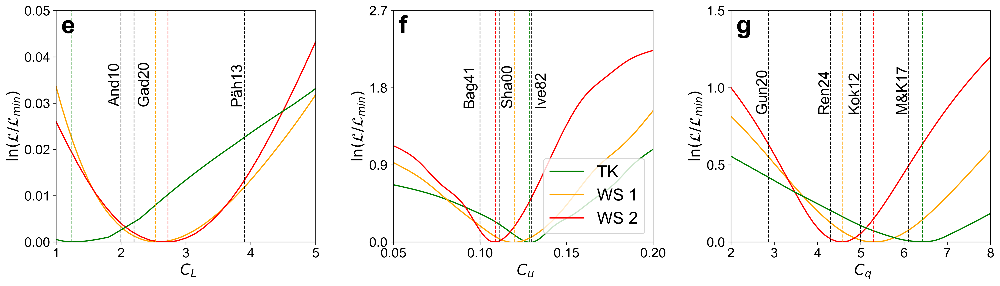

In [86]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(20, 5))
plt.rcParams['font.size'] = 16 # standard font size


Cqo_mf = Cq_vals_tk_forCq[np.log(loss_gridCq_tk/np.min(loss_gridCq_tk))==0]
Cqo_ws1 =Cq_vals_ws1[np.log(loss_gridCq_ws1/np.min(loss_gridCq_ws1))==0]
Cqo_ws0 = Cq_vals_ws0[np.log(loss_gridCq_ws0/np.min(loss_gridCq_ws0))==0]

ax[2].plot(Cq_vals_ws0,np.log(loss_gridCq_ws0/np.min(loss_gridCq_ws0)),color='orange')
ax[2].plot(Cq_vals_ws1,np.log(loss_gridCq_ws1/np.min(loss_gridCq_ws1)),color='red')
ax[2].plot(Cq_vals_tk_forCq,np.log(loss_gridCq_tk/np.min(loss_gridCq_tk)),color='green')
ax[2].plot(Cqo_mf*np.ones(100), np.linspace(0,10,100),'g--', linewidth=1)
ax[2].plot(Cqo_ws0*np.ones(100), np.linspace(0,10,100),'r--', linewidth=1)
ax[2].plot(Cqo_ws1*np.ones(100), np.linspace(0,10,100),'--', color='orange',linewidth=1)

ax[2].set_xlim(2,8)
ax[2].set_xticks(np.linspace(2,8,7))
ax[2].set_ylim(0,1.5)
ax[2].set_yticks(np.linspace(0,1.5,4))
ax[2].set_xlabel(r" $C_{q}$",fontsize=18)
ax[2].set_ylabel('$\\ln(\\mathcal{L}/\\mathcal{L}_{min})$',fontsize=18)

ax[2].plot(5*np.ones(100), np.linspace(0,2,100),'k--', linewidth=1)
ax[2].text(5-0.3, 0.85, "Kok12", color="black", fontsize=fs*1.8,rotation=90)

ax[2].plot(2.87*np.ones(100), np.linspace(0,2,100),'k--', linewidth=1)
ax[2].text(2.87-0.3, 0.85, "Gun20", color="black", fontsize=fs*1.8,rotation=90)

ax[2].plot(4.3*np.ones(100), np.linspace(0,2,100),'k--', linewidth=1)
ax[2].text(4.3-0.3, 0.85, "Ren24", color="black", fontsize=fs*1.8,rotation=90)

ax[2].plot(6.1*np.ones(100), np.linspace(0,2,100),'k--', linewidth=1)
ax[2].text(6.1-0.3, 0.85, "M&K17", color="black", fontsize=fs*1.8,rotation=90)

x1 = uth_vals_tkforCu * np.sqrt(rhof/(rhos_tk*grav*d_tk*1e-6))
y1 = np.log(loss_griduth_tk/np.min(loss_griduth_tk))
cs1 = CubicSpline(x1, y1, bc_type='natural')
x1_smooth = np.linspace(x1.min(), x1.max(), 100)
ax[1].plot(x1_smooth, cs1(x1_smooth), 'g-')

x2 = uth_val_ws0 * np.sqrt(rhof/(rhos*grav*d_ws*1e-6))
y2 = np.log(loss_griduth_ws0/np.min(loss_griduth_ws0))
cs2 = CubicSpline(x2, y2, bc_type='natural')
x2_smooth = np.linspace(x2.min(), x2.max(), 100)
ax[1].plot(x2_smooth, cs2(x2_smooth), '-', color='orange')

x3 = uth_val_ws1 * np.sqrt(rhof/(rhos*grav*d_ws*1e-6))
y3 = np.log(loss_griduth_ws1/np.min(loss_griduth_ws1))
cs3 = CubicSpline(x3, y3, bc_type='natural')
x3_smooth = np.linspace(x3.min(), x3.max(), 100)
ax[1].plot(x3_smooth, cs3(x3_smooth)-np.min(cs3(x3_smooth)), '-', color='red')


ax[1].legend(['TK','WS 1','WS 2'], fontsize=fs*2, loc='lower right')

utho_tk = x1_smooth[cs1(x1_smooth)==np.min(cs1(x1_smooth))]
utho_ws0 = x2_smooth[cs2(x2_smooth)==np.min(cs2(x2_smooth))]
utho_ws1 =x3_smooth[cs3(x3_smooth)==np.min(cs3(x3_smooth))]



ax[1].plot(utho_tk*np.ones(100), np.linspace(0,10,100),'g--', linewidth=1)
ax[1].plot(utho_ws0*np.ones(100), np.linspace(0,10,100),'--',color='orange', linewidth=1)
ax[1].plot(utho_ws1*np.ones(100), np.linspace(0,10,100),'--', color='red',linewidth=1)

ax[1].plot(0.1*np.ones(100), np.linspace(0,10,100),'k--',linewidth=1)
ax[1].text(0.1-0.01, 1.6, "Bag41", color="k", fontsize=fs*1.8,rotation=90)
ax[1].plot(0.111*np.ones(100), np.linspace(0,10,100),'k--',linewidth=1)
ax[1].text(0.111+0.001, 1.6, "Sha00", color="k", fontsize=fs*1.8,rotation=90)
ax[1].plot(0.13*np.ones(100), np.linspace(0,10,100),'k--',linewidth=1)
ax[1].text(0.13+0.001, 1.6, "Ive82", color="k", fontsize=fs*1.8,rotation=90)

ax[1].set_xlim(0.05,0.2)
ax[1].set_xticks(np.linspace(0.05,0.2,4))
ax[1].set_ylim(0,2.7)
ax[1].set_yticks(np.linspace(0,2.7,4))
ax[1].set_xlabel(r" $C_{u}$",fontsize=18)
ax[1].set_ylabel('$\\ln(\\mathcal{L}/\\mathcal{L}_{min})$',fontsize=18)


ax[0].plot(rhof*lsat_vals_ws0/(rhos*d_ws*1e-6),np.log(loss_gridlsat_ws0/np.min(loss_gridlsat_ws0)),color='orange')
ax[0].plot(rhof*lsat_vals_ws1/(rhos*d_ws*1e-6),np.log(loss_gridlsat_ws1/np.min(loss_gridlsat_ws1)),color='red')
ax[0].plot(rhof*lsat_vals_tkforCl/(rhos_tk*d_tk*1e-6),np.log(loss_gridlsat_tk/np.min(loss_gridlsat_tk)),color='green')

lsat_mf = lsat_vals_tkforCl[np.log(loss_gridlsat_tk/np.min(loss_gridlsat_tk))==0]
lsat_ws1 =lsat_vals_ws1[np.log(loss_gridlsat_ws1/np.min(loss_gridlsat_ws1))==0]
lsat_ws0 = lsat_vals_ws0[np.log(loss_gridlsat_ws0/np.min(loss_gridlsat_ws0))==0]

ax[0].plot(rhof/(rhos_tk*d_tk*1e-6)*lsat_mf*np.ones(100), np.linspace(0,1,100),'g--', linewidth=1)
ax[0].plot(rhof/(rhos*d_ws*1e-6)*lsat_ws1*np.ones(100), np.linspace(0,1,100),'r--', linewidth=1)
ax[0].plot(rhof/(rhos*d_ws*1e-6)*lsat_ws0*np.ones(100), np.linspace(0,1,100),'--', color='orange',linewidth=1)

ax[0].plot(2.2*np.ones(100), np.linspace(0,1,100),'k--',linewidth=1)
ax[0].text(2.25, 0.03, "Gad20", color="k", fontsize=fs*1.8,rotation=90)

ax[0].plot(2*np.ones(100), np.linspace(0,1,100),'k--',linewidth=1)
ax[0].text(1.8, 0.03, "And10", color="k", fontsize=fs*1.8,rotation=90)

ax[0].plot(3.9*np.ones(100), np.linspace(0,1,100),'k--',linewidth=1)
ax[0].text(3.68, 0.03, "Päh13", color="k", fontsize=fs*1.8,rotation=90)

ax[0].set_xlim(1,5)
ax[0].set_xticks(np.arange(1,5.0001,1))
ax[0].set_ylim(0,0.05)

ax[0].set_xlabel(r" $C_{L}$",fontsize=18)
ax[0].set_ylabel('$\\ln(\\mathcal{L}/\\mathcal{L}_{min})$',fontsize=18)



ax[2].text(0.02, 0.98, "g", transform=ax[2].transAxes, fontsize=fs * 3, fontweight='bold', va='top',color='k')
ax[1].text(0.02, 0.98, "f", transform=ax[1].transAxes, fontsize=fs * 3, fontweight='bold', va='top',color='k')
ax[0].text(0.02, 0.98, "e", transform=ax[0].transAxes, fontsize=fs * 3, fontweight='bold', va='top',color='k')

plt.subplots_adjust(wspace=0.3)

# Table M1 Comparation of different optimization methods

In [202]:
d_tk=180 # Gao et al. 2021
rhos_tk=2550 # Gao et al. 2021
dttk = xr.Dataset(
    {
        'z': (('x', 'y'),dftk.dunemask.isel(t=0).fillna(0).values)
    },
    coords={
        'x': (('x'), dftk.x.values - dftk.x.min().item()),
        'y': (('y'), dftk.y.values - dftk.y.min().item()),
    },
)

dttk = make_pad(dttk,'z','zp',padsl)
dttk= make_bubble(dttk,'zp','zb',recth,recsl)
dttk['zpb'] = xr.where(dttk.zb.isnull(), dttk.zp, dttk.zb)
dttk['zpbro'] = dttk.zpb-dttk.zp+dttk.z

qdata=dftk.qmask[0].values
qdem = np.zeros(dttk.z.shape)
x_offset = (dttk.x.size- qdata.shape[0]) // 2
y_offset = (dttk.y.size- qdata.shape[1]) // 2
qdem[x_offset:x_offset + qdata.shape[0], y_offset:y_offset + qdata.shape[1]] = qdata
dttk['qdem'] = (('x','y'),qdem)

start_time = pd.Timestamp(dftk.t[0].item()).tz_localize('UTC')
end_time = pd.Timestamp(dftk.t[1].item()).tz_localize('UTC')


In [197]:
def objective(params):
    ut, Cq ,lsat= params
    return fromfactor_tolossfunction(ut,Cq,lsat,dttk,dwtk,z01,start_time,end_time)

# bounds
bounds = [(0.2, 0.4),  # uth range
        (2, 8), # Cq range
        (0,1)]  # Clsat range

res_tk_LBFGSB = minimize(objective, [0.25,6.4,0.7], method='L-BFGS-B',bounds=bounds)

print("Results (L-BFGS-B TK):")
print("uth =", res_tk_LBFGSB.x[0])
print("Cq   =", res_tk_LBFGSB.x[1])
print("lsat   =", res_tk_LBFGSB.x[2])

Results (L-BFGS-B TK):
uth = 0.25395911699701385
Cq   = 6.4031099411409
lsat   = 0.6975805578781974


In [198]:
# bounds
bounds = [(0.2, 0.4),  # uth range
        (2, 8), # Cq range
        (0,1)]  # Clsat range

res_tk_TNC = minimize(objective, [0.25,5.8,0.7] , method='TNC', bounds=bounds,
                  options={'maxiter': 1000, 'eps': 1e-8, 'disp': True})

print("Results (TNC TK):")
print("uth =", res_tk_TNC.x[0])
print("Cq   =", res_tk_TNC.x[1])
print("lsat   =", res_tk_TNC.x[2])

/var/folders/hd/mh5dw4tx6516lkk5f82sfg481pk0nq/T/ipykernel_1493/2020583586.py:6: OptimizeWarning: Unknown solver options: maxiter
  res_tk_TNC = minimize(objective, [0.25,5.8,0.7] , method='TNC', bounds=bounds,
  NIT   NF   F                       GTG
    0    1  3.066361842447122E+00   3.34320879E+00
    1    8  2.907013677904895E+00   7.98454201E+00
    2   36  2.905752990735844E+00   1.15134672E+11
tnc: fscale = 1.47356e-05
    2   76  2.905752990735844E+00   1.15134672E+11
tnc: Linear search failed


Results (TNC TK):
uth = 0.25467484867682916
Cq   = 6.419999068032139
lsat   = 0.6903448787270711


In [199]:
# bounds
bounds = [(0.2, 0.4),  # uth range
        (2, 8), # Cq range
        (0,1)]  # Clsat range


res_tk_SLSQP = minimize(objective, [0.25,6.6,0.7], method='SLSQP', bounds=bounds,
                  options={'maxiter': 10000, 'ftol': 1e-8, 'disp': True})


print("Results (SLSQP TK):")
print("uth =", res_tk_SLSQP.x[0])
print("Cq   =", res_tk_SLSQP.x[1])
print("lsat   =", res_tk_SLSQP.x[2])

Optimization terminated successfully    (Exit mode 0)
            Current function value: 2.893847163109766
            Iterations: 35
            Function evaluations: 226
            Gradient evaluations: 33
Results (SLSQP TK):
uth = 0.2532732363017176
Cq   = 6.387351548875677
lsat   = 0.4509616886013324


In [200]:
import warnings
warnings.filterwarnings('ignore')

x0 = [0.23, 6.8, 0.7]  

bounds = [(0.2, 0.4), (2, 8), (0, 1)]

res_tk_tc = minimize(objective, x0, method='trust-constr', bounds=bounds,
                  options={'verbose': 1, 'maxiter': 1000, 'gtol': 1e-8})

print("Results (trust-constr TK):")
print("uth =", res_tk_tc.x[0])
print("Cq   =", res_tk_tc.x[1])
print("lsat   =", res_tk_tc.x[2])

`xtol` termination condition is satisfied.
Number of iterations: 453, function evaluations: 2852, CG iterations: 550, optimality: 2.35e+02, constraint violation: 0.00e+00, execution time: 5.6e+02 s.
Results (trust-constr TK):
uth = 0.25327327090225027
Cq   = 6.443288903318736
lsat   = 0.47781462330086977


In [205]:
constraints = [NonlinearConstraint(lambda x: 0.245, 0.2, 0.4),
               NonlinearConstraint(lambda x: 6.33, 2, 8),
               NonlinearConstraint(lambda x: 0.7, 0, 1)]

res_tk_nm = minimize(objective, [0.245,6.33,0.7]  , method='Nelder-Mead', 
                  options={'maxiter': 1000, 'xatol': 1e-8, 'fatol': 1e-8, 'disp': True})


print("Results (Nelder-Mead TK):")
print("uth =", res_tk_nm.x[0])
print("Cq   =", res_tk_nm.x[1])
print("lsat   =", res_tk_nm.x[2])

Optimization terminated successfully.
         Current function value: 2.893848
         Iterations: 434
         Function evaluations: 808
Results (Nelder-Mead TK):
uth = 0.2532732825340549
Cq   = 6.387033072277392
lsat   = 0.45003475696073714


In [201]:
d_ws=400 # Jerolmack et al. 2011 (White Sands)
start_time = pd.Timestamp(dfws.t[0].item()).tz_localize('UTC')
end_time = pd.Timestamp(dfws.t[1].item()).tz_localize('UTC')

zdata=dfws.zre[0].values[3000:4500,:]
dt = xr.Dataset(data_vars=dict(z=(['x','y'],zdata)),
                coords=dict(x=(['x'],np.arange(zdata.shape[0])),
                            y=(['y'],np.arange(zdata.shape[1]))))

dt = make_pad(dt,'z','zp',padsl)
dt = make_bubble(dt,'zp','zb',recth,recsl)
qdata=dfws.qre[0].values[3000:4500,:]
qdem = np.zeros(dt.z.shape)
x_offset = (dt.x.size- qdata.shape[0]) // 2
y_offset = (dt.y.size- qdata.shape[1]) // 2
qdem[x_offset:x_offset + qdata.shape[0], y_offset:y_offset + qdata.shape[1]] = qdata
dt['qdem'] = (('x','y'),qdem)

In [187]:
def objective(params):
    ut, Cq,lsat = params
    return fromfactor_tolossfunction_ws(ut,Cq,lsat,dt,dwws,start_time,end_time)


x0 = [0.325,5,1.7]  

# bounds
bounds = [(0.2, 0.4),  # uth range
        (2, 8),    # Cq range
        (1.5,2)]  # Clsat range

res0_LBFGSB = minimize(objective, x0, method='L-BFGS-B',bounds=bounds)

print("Results (L-BFGS-B WS1):")
print("uth =", res0_LBFGSB.x[0])
print("Cq   =", res0_LBFGSB.x[1])
print("lsat   =", res0_LBFGSB.x[2])

Results (L-BFGS-B WS1):
uth = 0.3205101413387503
Cq   = 5.016138589474365
lsat   = 1.7090303158567581


In [188]:
res0_TNC = minimize(objective, [0.325,4,1.7] , method='TNC', bounds=bounds,
                  options={'maxiter': 1000, 'eps': 1e-8, 'disp': True})

print("Results (TNC WS1):")
print("uth =", res0_TNC.x[0])
print("Cq   =", res0_TNC.x[1])
print("lsat   =", res0_TNC.x[2])

/var/folders/hd/mh5dw4tx6516lkk5f82sfg481pk0nq/T/ipykernel_1493/1644645022.py:1: OptimizeWarning: Unknown solver options: maxiter
  res0_TNC = minimize(objective, [0.325,4,1.7] , method='TNC', bounds=bounds,
  NIT   NF   F                       GTG
    0    1  7.040854069250677E+00   5.61226585E+00
    1    5  5.859018029846977E+00   1.95545378E+01
    2   37  5.824113331567554E+00   1.47721110E+01
tnc: |fn-fn-1] = 4.44089e-15 -> convergence
    3   40  5.824113331567549E+00   1.47721122E+01
tnc: Converged (|f_n-f_(n-1)| ~= 0)


Results (TNC WS1):
uth = 0.32050932772402096
Cq   = 5.02842583665179
lsat   = 1.7014610573479254


In [189]:
res0_SLSQP = minimize(objective, [0.35,5.05,1.7]  , method='SLSQP', bounds=bounds,
                  options={'maxiter': 1000, 'ftol': 1e-8, 'disp': True})

print("Results (SLSQP WS1):")
print("uth =", res0_SLSQP.x[0])
print("Cq   =", res0_SLSQP.x[1])
print("lsat   =", res0_SLSQP.x[2])

Optimization terminated successfully    (Exit mode 0)
            Current function value: 5.799554659289462
            Iterations: 28
            Function evaluations: 250
            Gradient evaluations: 28
Results (SLSQP WS1):
uth = 0.3205093280277639
Cq   = 5.035948890146443
lsat   = 1.790275087732244


In [190]:
start_time = pd.Timestamp(dfws.t[1].item()).tz_localize('UTC')
end_time = pd.Timestamp(dfws.t[2].item()).tz_localize('UTC')

zdata=dfws.zre[1].values[3000:4500,:]
dt = xr.Dataset(data_vars=dict(z=(['x','y'],zdata)),
                coords=dict(x=(['x'],np.arange(zdata.shape[0])),
                            y=(['y'],np.arange(zdata.shape[1]))))

dt = make_pad(dt,'z','zp',padsl)
dt = make_bubble(dt,'zp','zb',recth,recsl)
qdata=dfws.qre[1].values[3000:4500,:]
qdem = np.zeros(dt.z.shape)
x_offset = (dt.x.size- qdata.shape[0]) // 2
y_offset = (dt.y.size- qdata.shape[1]) // 2
qdem[x_offset:x_offset + qdata.shape[0], y_offset:y_offset + qdata.shape[1]] = qdata
dt['qdem'] = (('x','y'),qdem)

In [191]:
def objective(params):
    ut, Cq ,lsat= params
    return fromfactor_tolossfunction_ws(ut,Cq,lsat,dt,dwws,start_time,end_time)

x0 = [0.32,5,1.7]  

# bounds
bounds = [(0.2, 0.4),  # uth range
        (2, 8), # Cq range
        (1.5,2)]  # Clsat range

res1_LBFGSB = minimize(objective, x0, method='L-BFGS-B',bounds=bounds)

print("Results (L-BFGS-B WS2):")
print("uth =", res1_LBFGSB.x[0])
print("Cq   =", res1_LBFGSB.x[1])
print("lsat   =", res1_LBFGSB.x[2])

Results (L-BFGS-B WS2):
uth = 0.297806601561161
Cq   = 4.7872037155726135
lsat   = 1.7340712514435976


In [192]:
def objective(params):
    ut, Cq ,lsat= params
    return fromfactor_tolossfunction_ws(ut,Cq,lsat,dt,dwws,start_time,end_time)

bounds = [(0.2, 0.4),  # uth range
        (2, 8),     # Cq range
        (1.5,2)]  # Clsat range

res1_TNC = minimize(objective, [0.3,4.95,1.7]    , method='TNC', bounds=bounds,
                  options={'maxiter': 1000, 'eps': 1e-8, 'disp': True})

print("Results (TNC WS2):")
print("uth =", res1_TNC.x[0])
print("Cq   =", res1_TNC.x[1])
print("lsat   =", res1_TNC.x[2])

/var/folders/hd/mh5dw4tx6516lkk5f82sfg481pk0nq/T/ipykernel_1493/1339720657.py:9: OptimizeWarning: Unknown solver options: maxiter
  res1_TNC = minimize(objective, [0.3,4.95,1.7]    , method='TNC', bounds=bounds,
  NIT   NF   F                       GTG
    0    1  5.235820579704345E+00   1.97369404E+02
    1   33  5.046811874060710E+00   8.27756156E+01
tnc: |fn-fn-1] = 1.77636e-15 -> convergence
    2   36  5.046811874060708E+00   8.27756140E+01
tnc: Converged (|f_n-f_(n-1)| ~= 0)


Results (TNC WS2):
uth = 0.29780658362628953
Cq   = 4.778884855750951
lsat   = 1.700492415018965


In [193]:
res1_SLSQP = minimize(objective, [0.32,4.75,1.7]  , method='SLSQP', bounds=bounds,
                  options={'maxiter': 200, 'ftol': 1e-8, 'disp': True})

print("Results (SLSQP WS2):")
print("uth =", res1_SLSQP.x[0])
print("Cq   =", res1_SLSQP.x[1])
print("lsat   =", res1_SLSQP.x[2])

Optimization terminated successfully    (Exit mode 0)
            Current function value: 4.959946329838896
            Iterations: 48
            Function evaluations: 355
            Gradient evaluations: 46
Results (SLSQP WS2):
uth = 0.2978065886122693
Cq   = 4.6077653415593165
lsat   = 1.7673455708843477


# Figure M1

In [23]:
def read_dem(file_path):

    with rasterio.open(file_path) as src:
        dem_data = src.read(1) 
        x_coords = np.linspace(src.bounds.left, src.bounds.right, src.width)
        y_coords = np.linspace(src.bounds.top, src.bounds.bottom, src.height)
        return dem_data
    

dem_datamf = read_dem('/Users/ylin0188/Desktop/code box/dfsframework code/Taklamakan Barchan/TKbarchan250225.tif')
dem_datamf[dem_datamf<=0]=np.nan

repose = np.tan(30*np.pi/180)
z = dem_datamf[1:30000:470, 1:-1:470]
dzdx = np.gradient(z,axis=1)
dzdy = np.gradient(z,axis=0)
dzdx[(dzdx**2+dzdy**2)**0.5<repose] = np.nan
dzdy[(dzdx**2+dzdy**2)**0.5<repose] = np.nan
aez=np.arctan2(-dzdy,-dzdx)*180/np.pi
mask = (aez > 80) | (aez < -100)
aez[mask] = np.nan

valid_mask = ~np.isnan(aez)

dem_datamf_d=dem_datamf[0:30000:50,0:-1:50]

# calculate upscaling factors
scale_y = dem_datamf_d.shape[0] / aez.shape[0]
scale_x = dem_datamf_d.shape[1] / aez.shape[1]

# upscaling mask using nearest neighbor
valid_mask_upscaled = ndimage.zoom(valid_mask.astype(float), 
                                   (scale_y, scale_x), 
                                   order=0) > 0.5


# apply to full DEM
dem_full_masked = dem_datamf_d.copy()
dem_full_masked[~valid_mask_upscaled] = np.nan

dzdx = np.gradient(dem_datamf_d,axis=1)
dzdy = np.gradient(dem_datamf_d,axis=0)
angles=np.arctan2(-dzdy,-dzdx)*180/np.pi

angle_mask = (angles >= -90) & (angles <= 90) & ((dzdx**2+dzdy**2)**0.5>=0.06)
angles = angles.copy()
angles[~angle_mask] = np.nan

binary_image = angle_mask

# label connected components
labeled_array, num_features = ndimage.label(binary_image, structure=np.ones((3, 3)))

if num_features > 0:
    # calculte sizes of connected components
    sizes = ndimage.sum(binary_image, labeled_array, range(1, num_features + 1))
    
    # find the label of the largest connected component
    largest_label = np.argmax(sizes) + 1
    largest_size = sizes[largest_label - 1]
    
    # mask for the largest connected component
    largest_mask = labeled_array == largest_label

angles = angles.copy()
angles[~largest_mask] = np.nan

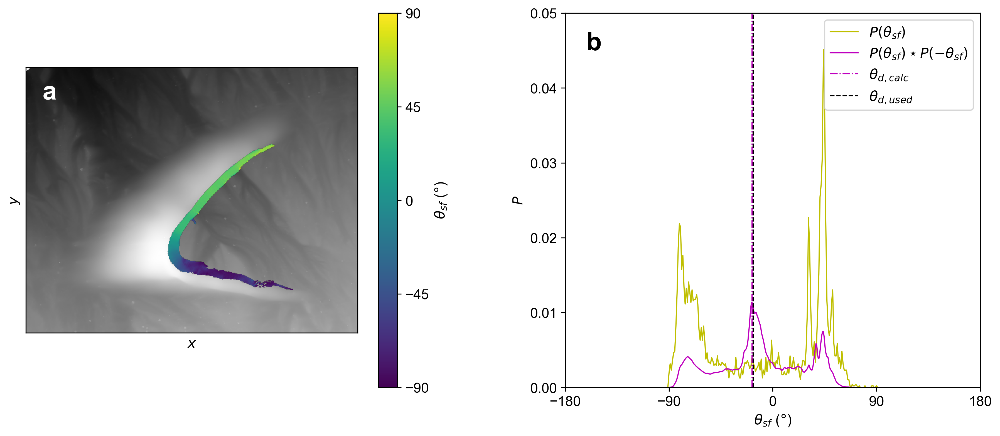

In [51]:
def ridspuriousangles(acnt,abinmids):
    ta = np.copy(acnt)
    for i in np.arange(-8,8)*45:
        ti = np.argwhere(abinmids==i)
        ta[ti] = (ta[ti-1]+ta[ti+1])/2
    ti = np.argwhere(abinmids==8*45)
    ta[-1] = (ta[-2]+ta[0])/2
    return ta

af0 = -17 # direction clockwise from east in degrees that the dunes move
da = 0.5
abins = np.arange(-360-da,360+2*da,2*da)
abinmids = abins[1:] - da


ae_ela_selected =angles
tempa = ae_ela_selected[~np.isnan(ae_ela_selected)]
acnt,_ = np.histogram(tempa,bins=abins)
tempc = ridspuriousangles(acnt,abinmids)
p = correlate(tempc,np.flip(tempc),mode='same')

tempdd = abinmids[np.argmax(p)]/2


plt.figure(figsize=(12, 5))

plt.subplot(1,2,1)
plt.imshow(dem_datamf_d, aspect='equal', cmap='gray')

plt.imshow(angles, aspect='equal')
cbar=plt.colorbar(label='$\\theta_{sf}$ ($\degree$)')
cbar.set_ticks([-90,-45,0,45,90])

plt.xlim(200,700)
plt.ylim(600,200)
plt.xticks([])
plt.yticks([])
plt.xlabel('$x$')
plt.ylabel('$y$')
plt.tight_layout()
plt.text(0.05, 0.95, 'a', transform=plt.gca().transAxes,
         fontsize=22, fontweight='bold',color='w',
         verticalalignment='top')
# plt.legend()

plt.subplot(1,2,2)
plt.plot(abinmids,acnt/np.sum(acnt),c='y',lw=1,label='$P(\\theta_{sf})$')
plt.plot(abinmids/2,p/np.sum(p),c='m',lw=1,label='$P(\\theta_{sf})\\star P(-\\theta_{sf})$')
plt.plot([tempdd,tempdd],[0,1.2*np.max(acnt/np.sum(acnt))],'-.m',lw=1,label='$\\theta_{d,calc}$')
plt.plot([af0,af0],[0,1.2*np.max(acnt/np.sum(acnt))],'--k',lw=1,label='$\\theta_{d,used}$')
plt.xlabel('$\\theta_{sf}$ ($\degree$)')
plt.ylabel('$P$')
plt.xlim(-180,180)
plt.xticks([-180,-90,0,90,180])
plt.ylim(0,0.05)
plt.legend()
plt.text(0.05, 0.95, 'b', transform=plt.gca().transAxes,
         fontsize=22, fontweight='bold',color='k',
         verticalalignment='top')

plt.subplots_adjust(wspace=0.3)


/var/folders/hd/mh5dw4tx6516lkk5f82sfg481pk0nq/T/ipykernel_23311/552140740.py:44: RuntimeWarning: invalid value encountered in log10
  plt.pcolormesh(Re,Re_d,np.log10(abcd[i]*(-1 if i==2 else 1)).T,vmin=cbarticks[0],vmax=cbarticks[-1],cmap='summer')
/var/folders/hd/mh5dw4tx6516lkk5f82sfg481pk0nq/T/ipykernel_23311/552140740.py:46: RuntimeWarning: invalid value encountered in log10
  plt.pcolormesh(Re,Re_d,np.log10(abcd[i]*(-1 if i==2 else 1)).T,vmin=cbarticks[0],vmax=cbarticks[-1],cmap='autumn')


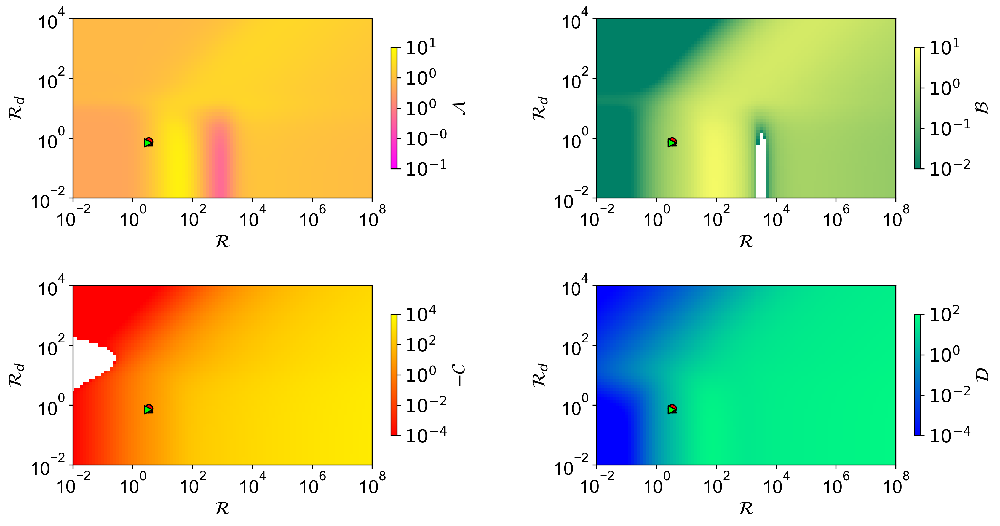

In [134]:
Re_d = np.logspace(-2,4, 60+1) # Re for saved solutions
Re   = np.logspace(-2,8,100+1) # Re_d for saved solutions

with open('abcd.txt','r') as f:
    lines = f.readlines()
    lines = [line.strip() for line in lines if line.strip() and not line.startswith('#')]
    abcd = np.array([list(map(float,line.split())) for line in lines]).reshape((4,len(Re),len(Re_d)))

cbartickss = [np.linspace(-1,1,4+1),
              np.linspace(-2,1,3+1),
              np.linspace(-4,4,4+1),
              np.linspace(-4,2,3+1)]
cbarlabels = ['$\\mathcal{A}$',
              '$\\mathcal{B}$',
              '$\\mathcal{-C}$',
              '$\\mathcal{D}$']

from scipy.fft import fftfreq
x=dtws.x.data
kx = 2*np.pi*fftfreq(len(x),d=x[1]-x[0])[:,None]
kx[kx==0] = 1e-10
us0=0.40
ab0=np.mean(get_ab(us0/nu/np.abs(kx),d_ws*1e-9*us0/nu),axis=1)
us1=0.42
ab1=np.mean(get_ab(us1/nu/np.abs(kx),d_ws*1e-9*us1/nu),axis=1)
x=dt.x.data
kx = 2*np.pi*fftfreq(len(x),d=x[1]-x[0])[:,None]
kx[kx==0] = 1e-10
utk=0.32
abtk=np.mean(get_ab(utk/nu/np.abs(kx),d_tk*1e-9*utk/nu),axis=1)


# cbartickss = [np.linspace(-1,1,4+1),
#               np.linspace(-2,1,3+1)]
# cbarlabels = ['$\\mathcal{A}$',
#               '$\\mathcal{B}$']

plt.figure(figsize=(14,8),dpi=300)
for i,(cbarticks,cbarlabel) in enumerate(zip(cbartickss,cbarlabels)):
    plt.subplot(221+i)
    if i==0:
        plt.pcolormesh(Re,Re_d,np.log10(abcd[i]*(-1 if i==2 else 1)).T,vmin=cbarticks[0],vmax=cbarticks[-1],cmap='spring')
    if i==1:
        plt.pcolormesh(Re,Re_d,np.log10(abcd[i]*(-1 if i==2 else 1)).T,vmin=cbarticks[0],vmax=cbarticks[-1],cmap='summer')
    if i==2:
        plt.pcolormesh(Re,Re_d,np.log10(abcd[i]*(-1 if i==2 else 1)).T,vmin=cbarticks[0],vmax=cbarticks[-1],cmap='autumn')
    if i==3:
        plt.pcolormesh(Re,Re_d,np.log10(abcd[i]*(-1 if i==2 else 1)).T,vmin=cbarticks[0],vmax=cbarticks[-1],cmap='winter')
    cbar = plt.colorbar(label=cbarlabel,ticks=cbarticks,shrink=0.5)
    cbar.ax.set_yticklabels(['$10^{%.0f}$'%val for val in cbarticks])
    plt.xscale('log')
    plt.yscale('log')
    plt.axis('square')
    plt.xlim(Re[0],Re[-1])
    plt.ylim(Re_d[0],Re_d[-1])
    plt.xticks(np.logspace(-2,8,5+1))
    plt.yticks(np.logspace(-2,4,3+1))
    plt.xlabel('$\\mathcal{R}$')
    plt.ylabel('$\\mathcal{R}_d$')

    plt.scatter(ab0[0],ab0[1], s=50, marker='^', color='orange',edgecolors='k')
    plt.scatter(ab1[0],ab1[1],s=50, marker='o', color='r',edgecolors='k')
    plt.scatter(abtk[0],abtk[1],s=50,marker='>', color='#00FF00',edgecolors='k')


plt.subplots_adjust(wspace=0.4, hspace=0.1) 



# Figure M3

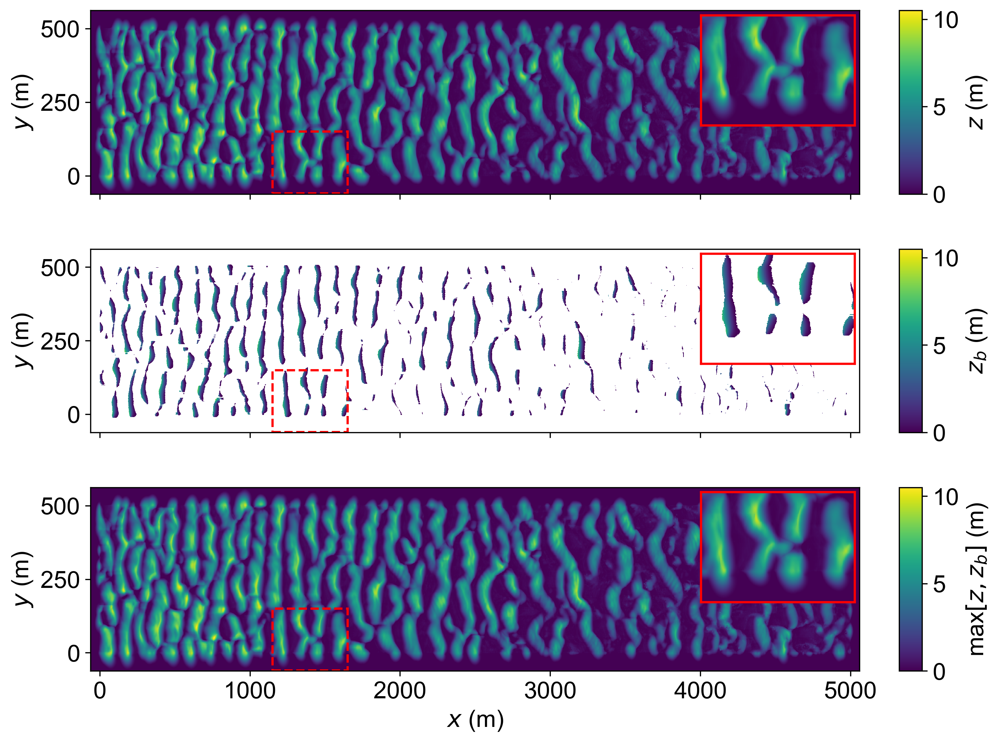

In [171]:
plt.figure(figsize=(10, 8))

gs = gridspec.GridSpec(
    3, 2,                
    width_ratios=[10, 0.3], 
    height_ratios=[1, 1, 1],
    wspace=0.1, hspace=0.3 
)

ax0 = plt.subplot(gs[0, 0])
cx0 = plt.subplot(gs[0, 1])
im0 = ax0.pcolormesh(dtws.x, dtws.y, dtws.zp.T, vmin=0, vmax=10.5)
cbar0 = plt.colorbar(im0, cax=cx0, label='$z$ (m)')
ax0.set_yticks([0, 250, 500])
ax0.set_ylabel('$y$ (m)')
ax0.set_xticklabels([])

ax0_inset = inset_axes(ax0, width="20%", height="60%", loc='upper right', borderpad=0.2)
x_range = (1150, 1650)
y_range = (dtws.y.min()+1, 150)
x_mask = (dtws.x >= x_range[0]) & (dtws.x <= x_range[1])
y_mask = (dtws.y >= y_range[0]) & (dtws.y <= y_range[1])
ax0_inset.pcolormesh(dtws.x[x_mask], dtws.y[y_mask], dtws.zp[x_mask, :][:, y_mask].T, 
                     vmin=0, vmax=10.5)
ax0_inset.set_xlim(x_range)
ax0_inset.set_ylim(y_range)
ax0_inset.set_xticks([])
ax0_inset.set_yticks([])
ax0_inset.spines[:].set_color('red')
ax0_inset.spines[:].set_linewidth(1.5)

rect0 = plt.Rectangle((x_range[0], y_range[0]), 
                      x_range[1]-x_range[0], 
                      y_range[1]-y_range[0],
                      fill=False, edgecolor='red', linestyle='--', linewidth=1.5)
ax0.add_patch(rect0)


ax1 = plt.subplot(gs[1, 0])
cx1 = plt.subplot(gs[1, 1])
im1 = ax1.pcolormesh(dtws.x, dtws.y, dtws.zb.T, vmin=0, vmax=10.5)
cbar1 = plt.colorbar(im1, cax=cx1, label='$z_b$ (m)')
ax1.set_yticks([0, 250, 500])
ax1.set_xticklabels([])
ax1.set_ylabel('$y$ (m)')
ax1_inset = inset_axes(ax1, width="20%", height="60%", loc='upper right', borderpad=0.2)
ax1_inset.pcolormesh(dtws.x[x_mask], dtws.y[y_mask], dtws.zb[x_mask, :][:, y_mask].T, 
                     vmin=0, vmax=10.5)
ax1_inset.set_xlim(x_range)
ax1_inset.set_ylim(y_range)
ax1_inset.set_xticks([])
ax1_inset.set_yticks([])
ax1_inset.spines[:].set_color('red')
ax1_inset.spines[:].set_linewidth(1.5)

rect1 = plt.Rectangle((x_range[0], y_range[0]), 
                      x_range[1]-x_range[0], 
                      y_range[1]-y_range[0],
                      fill=False, edgecolor='red', linestyle='--', linewidth=1.5)
ax1.add_patch(rect1)


ax2 = plt.subplot(gs[2, 0])
cx2 = plt.subplot(gs[2, 1])
im2 = ax2.pcolormesh(dtws.x, dtws.y, dtws.zb.where(~dtws.zb.isnull(), dtws.zp).data.T, 
                     vmin=0, vmax=10.5)
cbar2 = plt.colorbar(im2, cax=cx2, label='max$[z,z_b]$ (m)')
ax2.set_yticks([0, 250, 500])
ax2.set_xlabel('$x$ (m)')
ax2.set_ylabel('$y$ (m)')

ax2_inset = inset_axes(ax2, width="20%", height="60%", loc='upper right', borderpad=0.2)
zb_combined = dtws.zb.where(~dtws.zb.isnull(), dtws.zp).data
ax2_inset.pcolormesh(dtws.x[x_mask], dtws.y[y_mask], zb_combined[x_mask, :][:, y_mask].T, 
                     vmin=0, vmax=10.5)
ax2_inset.set_xlim(x_range)
ax2_inset.set_ylim(y_range)
ax2_inset.set_xticks([])
ax2_inset.set_yticks([])
ax2_inset.spines[:].set_color('red')
ax2_inset.spines[:].set_linewidth(1.5)

rect2 = plt.Rectangle((x_range[0], y_range[0]), 
                      x_range[1]-x_range[0], 
                      y_range[1]-y_range[0],
                      fill=False, edgecolor='red', linestyle='--', linewidth=1.5)
ax2.add_patch(rect2)


plt.show()

# Figure M4

In [ ]:
ut = res0.x[0]
Cq = res0.x[1]
lsat = res0.x[2] # saturation length

start_time = pd.Timestamp(dfws.t[0].item()).tz_localize('UTC')
end_time = pd.Timestamp(dfws.t[1].item()).tz_localize('UTC')

zdata=dfws.zre[0].values[3000:4500,:]
dt = xr.Dataset(data_vars=dict(z=(['x','y'],zdata)),
                coords=dict(x=(['x'],np.arange(zdata.shape[0])),
                            y=(['y'],np.arange(zdata.shape[1]))))

dt = make_pad(dt,'z','zp',padsl)
dt = make_bubble(dt,'zp','zb',recth,recsl)
qdata=dfws.qre[0].values[3000:4500,:]
qdem = np.zeros(dt.z.shape)
x_offset = (dt.x.size- qdata.shape[0]) // 2
y_offset = (dt.y.size- qdata.shape[1]) // 2
qdem[x_offset:x_offset + qdata.shape[0], y_offset:y_offset + qdata.shape[1]] = qdata
dt['qdem'] = (('x','y'),qdem)

dw_period1 = dwws.where((dwws.time >= start_time) & (dwws.time <= end_time) & (dwws.speed*kap/np.log(10/z00) >=ut), drop=True)
dw_period1['stree_velocity'] = dw_period1['speed']*kap/np.log(10/z00)

us=dw_period1['stree_velocity'].mean().item()#representative value
dt['uxs'] = (('x','y'),get_usxy_xy(get_taupxy_xy(dt.x.data,dt.y.data,dt.zb.where(~dt.zb.isnull(),dt.zp).data,d,us,nu),us).real)
dt['uxs'] = dt.uxs.where(dt.zb.isnull(),0).clip(0,None)


dt = dt.assign_coords(time=dw_period1.time.data)
dt['ux'] = (('time'),dw_period1['stree_velocity'].data)
dt['uxt'] = dt.ux/us*dt.uxs
dt['qs'] = (dt.uxt**2-ut**2)*Cq*ut*rhof/rhos*grav
dt['qs'] = dt.qs.where(dt.qs>0,0)

dx = dt.x.isel(x=slice(None,2)).diff('x').data[0]

q = np.zeros(dt.qs.shape) # true flux array initialised
q[:,0] = 0 # input true flux at x=0, here just arbitrary
dx=dt.x.isel(x=slice(None,2)).diff('x').data[0]
for i in range(1,q.shape[1]):
    q[:,i] = (q[:,i-1]+dx*dt.qs.data[:,i]/lsat)/(1+dx/lsat) # loop through and make true flux
dt['q'] = (('time','x','y'),q)
dt['qspt'] = dt.q.mean('time') * 365.25 * 24


q_spt=[]
q_dem=[]


for y_disp in range((dt.y.size-501)//2, (dt.y.size-501)//2+501):
    z_y=dt.z[(dt.x.size-1500)//2:(dt.x.size-1500)//2+1500,y_disp]
    qspt_y=dt.qspt[(dt.x.size-1500)//2:(dt.x.size-1500)//2+1500,y_disp]
    qdem_y=dt.qdem[(dt.x.size-1500)//2:(dt.x.size-1500)//2+1500,y_disp]

    #find valleys to divide 2D dune profile into segments 
    peaks, properties = find_peaks(-z_y, prominence=0.5, distance=80)
    del properties
    valley_pos = peaks[z_y[peaks] < 3]
    del peaks

    # find qcrest of dem and spt(fft)
    for x_disp in range(1,len(valley_pos)):
        startIDx=valley_pos[x_disp-1]
        endIDx=valley_pos[x_disp]
        segment_z=z_y[startIDx:endIDx]
        segment_qspt=qspt_y[startIDx:endIDx]
        segment_qdem=qdem_y[startIDx:endIDx]

        q_spt.append(segment_qspt[segment_z.values ==segment_z.max().values])
        q_dem.append(segment_qdem[segment_z.values ==segment_z.max().values])

q_spt0 = np.array(q_spt, dtype=np.float64).flatten()
q_dem0 = np.array(q_dem, dtype=np.float64).flatten()

ut = res1.x[0]
Cq = res1.x[1]
lsat = res1.x[2] # saturation length

start_time = pd.Timestamp(dfws.t[1].item()).tz_localize('UTC')
end_time = pd.Timestamp(dfws.t[2].item()).tz_localize('UTC')

zdata=dfws.zre[1].values[3000:4500,:]
dt = xr.Dataset(data_vars=dict(z=(['x','y'],zdata)),
                coords=dict(x=(['x'],np.arange(zdata.shape[0])),
                            y=(['y'],np.arange(zdata.shape[1]))))

dt = make_pad(dt,'z','zp',padsl)
dt = make_bubble(dt,'zp','zb',recth,recsl)
qdata=dfws.qre[1].values[3000:4500,:]
qdem = np.zeros(dt.z.shape)
x_offset = (dt.x.size- qdata.shape[0]) // 2
y_offset = (dt.y.size- qdata.shape[1]) // 2
qdem[x_offset:x_offset + qdata.shape[0], y_offset:y_offset + qdata.shape[1]] = qdata
dt['qdem'] = (('x','y'),qdem)

dw_period1 = dwws.where((dwws.time >= start_time) & (dwws.time <= end_time) & (dwws.speed*kap/np.log(10/z00) >=ut), drop=True)
# dw_period1 = dw.where((dw.time >= start_time) & (dw.time <= end_time) & (dw.speed!=0) , drop=True)
dw_period1['stree_velocity'] = dw_period1['speed']*kap/np.log(10/z00)

us=dw_period1['stree_velocity'].mean().item()#representative value
dt['uxs'] = (('x','y'),get_usxy_xy(get_taupxy_xy(dt.x.data,dt.y.data,dt.zb.where(~dt.zb.isnull(),dt.zp).data,d,us,nu),us).real)
dt['uxs'] = dt.uxs.where(dt.zb.isnull(),0).clip(0,None)


dt = dt.assign_coords(time=dw_period1.time.data)
dt['ux'] = (('time'),dw_period1['stree_velocity'].data)
dt['uxt'] = dt.ux/us*dt.uxs
dt['qs'] = (dt.uxt**2-ut**2)*Cq*ut*rhof/rhos*grav
dt['qs'] = dt.qs.where(dt.qs>0,0)

dx = dt.x.isel(x=slice(None,2)).diff('x').data[0]

q = np.zeros(dt.qs.shape) # true flux array initialised
q[:,0] = 0 # input true flux at x=0, here just arbitrary
dx=dt.x.isel(x=slice(None,2)).diff('x').data[0]
for i in range(1,q.shape[1]):
    q[:,i] = (q[:,i-1]+dx*dt.qs.data[:,i]/lsat)/(1+dx/lsat) # loop through and make true flux
dt['q'] = (('time','x','y'),q)
dt['qspt'] = dt.q.mean('time') * 365.25 * 24


q_spt=[]
q_dem=[]

for y_disp in range((dt.y.size-501)//2, (dt.y.size-501)//2+501):
    z_y=dt.z[(dt.x.size-1500)//2:(dt.x.size-1500)//2+1500,y_disp]
    qspt_y=dt.qspt[(dt.x.size-1500)//2:(dt.x.size-1500)//2+1500,y_disp]
    qdem_y=dt.qdem[(dt.x.size-1500)//2:(dt.x.size-1500)//2+1500,y_disp]

    #find valleys to divide 2D dune profile into segments 
    peaks, properties = find_peaks(-z_y, prominence=0.5, distance=80)
    del properties
    valley_pos = peaks[z_y[peaks] < 3]
    del peaks

    # find qcrest of dem and spt(fft)
    for x_disp in range(1,len(valley_pos)):
        startIDx=valley_pos[x_disp-1]
        endIDx=valley_pos[x_disp]
        segment_z=z_y[startIDx:endIDx]
        segment_qspt=qspt_y[startIDx:endIDx]
        segment_qdem=qdem_y[startIDx:endIDx]

        q_spt.append(segment_qspt[segment_z.values ==segment_z.max().values])
        q_dem.append(segment_qdem[segment_z.values ==segment_z.max().values])

q_spt1 = np.array(q_spt, dtype=np.float64).flatten()
q_dem1 = np.array(q_dem, dtype=np.float64).flatten()

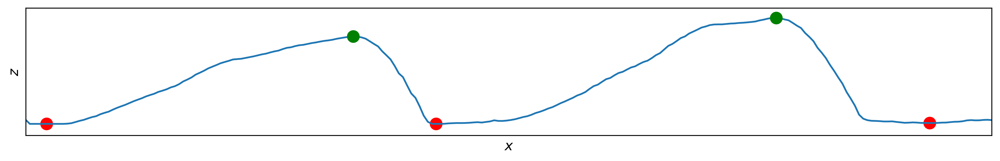

In [ ]:
peakloc=[]
q_spt=[]
q_dem=[]
y_disp=300
z_y=dt.z[(dt.x.size-1500)//2:(dt.x.size-1500)//2+1500,y_disp]
qspt_y=dt.qspt[(dt.x.size-1500)//2:(dt.x.size-1500)//2+1500,y_disp]
qdem_y=dt.qdem[(dt.x.size-1500)//2:(dt.x.size-1500)//2+1500,y_disp]
x_example=dt.x[(dt.x.size-1500)//2:(dt.x.size-1500)//2+1500]

peaks, properties = find_peaks(-z_y, prominence=0.5, distance=80)
# del properties
valley_pos = peaks[z_y[peaks] < 3]
for x_disp in range(1,len(valley_pos)):
    startIDx=valley_pos[x_disp-1]
    endIDx=valley_pos[x_disp]
    segment_z=z_y[startIDx:endIDx]
    segment_qspt=qspt_y[startIDx:endIDx]
    segment_qdem=qdem_y[startIDx:endIDx]
    q_spt.append(segment_qspt[segment_z.values ==segment_z.max().values])
    q_dem.append(segment_qdem[segment_z.values ==segment_z.max().values])

qspt_y=qspt_y[6:-1]
qdem_y=qdem_y[6:-1]

plt.figure(figsize=(15,2))
plt.plot(z_y)
plt.scatter(valley_pos, z_y[valley_pos], s=100, color='red')

if hasattr(z_y, 'values'):
    z_y_values = z_y.values
else:
    z_y_values = z_y

for x_disp in range(1,len(valley_pos)):
    start_idx = valley_pos[x_disp-1]
    end_idx = valley_pos[x_disp]

    if start_idx < end_idx:
        z_y_segment = z_y_values[start_idx:end_idx+1]
        max_idx_in_segment = np.argmax(z_y_segment)
        max_idx = start_idx + max_idx_in_segment

        plt.scatter(max_idx, z_y_values[max_idx], color='green', s=100, 
                   zorder=5, marker='o', label=f'Max at {max_idx}')

plt.xlim(742,975)
plt.ylim(-0.8,8)
plt.xticks([])
plt.yticks([])
plt.xlabel('$x$')
plt.ylabel('$z$')
if 'label' in plt.gca().get_legend_handles_labels()[1]:
    plt.legend()
plt.show()

In [ ]:
dt = xr.Dataset(
    {
        'z': (('x', 'y'),dftk.dunemask.isel(t=0).fillna(0).values)
    },
    coords={
        'x': (('x'), dftk.x.values - dftk.x.min().item()),
        'y': (('y'), dftk.y.values - dftk.y.min().item()),
    },
)

dt = make_pad(dt,'z','zp',padsl)
dt= make_bubble(dt,'zp','zb',recth,recsl)
dt['zpb'] = xr.where(dt.zb.isnull(), dt.zp, dt.zb)
dt['zpbro'] = dt.zpb-dt.zp+dt.z

qdata=dftk.qmask[0].values
qdem = np.zeros(dt.z.shape)
x_offset = (dt.x.size- qdata.shape[0]) // 2
y_offset = (dt.y.size- qdata.shape[1]) // 2
qdem[x_offset:x_offset + qdata.shape[0], y_offset:y_offset + qdata.shape[1]] = qdata
dt['qdem'] = (('x','y'),qdem)

start_time = pd.Timestamp(dftk.t[0].item()).tz_localize('UTC')
end_time = pd.Timestamp(dftk.t[1].item()).tz_localize('UTC')

ut = res_tk.x[0]
Cq = res_tk.x[1]
lsat = res_tk.x[2]
dw_period1 = dwtk.where((dwtk.time >= start_time) & (dwtk.time <= end_time) & (dwtk.speed*kap/np.log(z01/z00) >=ut))
dw_period1['stree_velocity'] = dw_period1['speed']*kap/np.log(z01/z00)
dw_period1 = dw_period1.dropna()

us=dw_period1['stree_velocity'].mean().item()#representative value
dt['uxs'] = (('x','y'),get_usxy_xy(get_taupxy_xy(dt.x.data,dt.y.data,dt.zb.where(~dt.zb.isnull(),dt.zp).data,d,us,nu),us).real)
dt['uxs'] = dt.uxs.where(dt.zb.isnull(),0).clip(0,None)


dt = dt.assign_coords(time=dw_period1.time)
dt['ux'] = (('time'),dw_period1['stree_velocity'])
dt['uxt'] = dt.ux/us*dt.uxs
dt['qs'] = (dt.uxt**2-ut**2)*Cq*ut*rhof/rhos*grav
dt['qs'] = dt.qs.where(dt.qs>0,0)

dx = dt.x.isel(x=slice(None,2)).diff('x').data[0]

q = np.zeros(dt.qs.shape) # true flux array initialised
q[:,0] = 0 # input true flux at x=0, here just arbitrary
dx=dt.x.isel(x=slice(None,2)).diff('x').data[0]
for i in range(1,q.shape[1]):
    q[:,i] = (q[:,i-1]+dx*dt.qs.data[:,i]/lsat)/(1+dx/lsat) # loop through and make true flux
dt['q'] = (('time','x','y'),q)
dt['qspt'] = dt.q.mean('time') * 365.25 * 24

q_spt=[]
q_dem=[]

for y_disp in range(dftk.y.shape[0]):
    z_y=dt.z[:,y_disp]   
    qspt_y=dt.qspt[:,y_disp]
    qdem_y=dt.qdem[:,y_disp]

    if z_y.max()>0:

        q_spt.append(qspt_y[z_y ==z_y.max().values])
        q_dem.append(qdem_y[z_y ==z_y.max().values])
q_spt_mf = np.array(q_spt, dtype=np.float64).flatten()
q_dem_mf = np.array(q_dem, dtype=np.float64).flatten()
invalid_indices = (q_dem_mf<=2.5) | (q_spt_mf<=2.5)
q_dem_mf = q_dem_mf[~invalid_indices]
q_spt_mf = q_spt_mf[~invalid_indices]

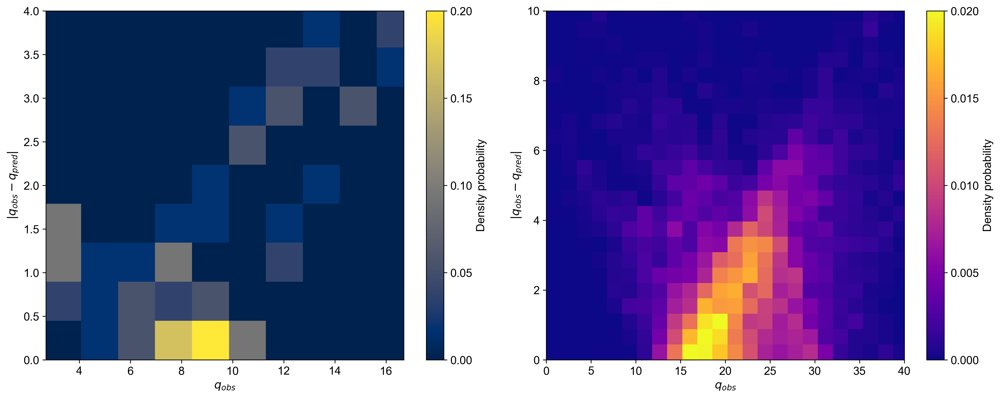

In [65]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

h1 = ax2.hist2d(np.concatenate([q_dem0, q_dem1]), 
                np.concatenate([np.abs(q_dem0-q_spt0)/2, np.abs(q_dem1-q_spt1)/2]), 
                bins=30,cmap='plasma' , density=True,vmax=0.02)
ax2.set_ylim(0, 10)
ax2.set_xlim(0, 40)
plt.colorbar(h1[3], ax=ax2, label='Density probability', 
             ticks=[0, 0.005, 0.01, 0.015, 0.02])
ax2.set_xlabel('$q_{obs}$')
ax2.set_ylabel('$|q_{obs} - q_{pred}|$')


h2 = ax1.hist2d(q_dem_mf, np.abs(q_spt_mf-q_dem_mf)/2, 
                bins=10, cmap='cividis', density=True,vmax=0.2)
ax1.set_ylim(0, 4)
ax1.set_xlim(2.7, 16.7)
plt.colorbar(h2[3], ax=ax1, label='Density probability',
             ticks=[0, 0.05, 0.1, 0.15, 0.2])
ax1.set_xlabel('$q_{obs}$')
ax1.set_ylabel('$|q_{obs} - q_{pred}|$')

plt.tight_layout()
plt.show()
